# Deep Convolutional GANs

In this notebook, you'll build a GAN using convolutional layers in the generator and discriminator. This is called a Deep Convolutional GAN, or DCGAN for short. The DCGAN architecture was first explored last year and has seen impressive results in generating new images, you can read the [original paper here](https://arxiv.org/pdf/1511.06434.pdf).

You'll be training DCGAN on the [Street View House Numbers](http://ufldl.stanford.edu/housenumbers/) (SVHN) dataset. These are color images of house numbers collected from Google street view. SVHN images are in color and much more variable than MNIST. 

![SVHN Examples](assets/SVHN_examples.png)

So, we'll need a deeper and more powerful network. This is accomplished through using convolutional layers in the discriminator and generator. It's also necessary to use batch normalization to get the convolutional networks to train. The only real changes compared to what [you saw previously](https://github.com/udacity/deep-learning/tree/master/gan_mnist) are in the generator and discriminator, otherwise the rest of the implementation is the same.

In [1]:
%matplotlib inline

import pickle as pkl

import matplotlib.pyplot as plt
import numpy as np
from scipy.io import loadmat
import tensorflow as tf

In [2]:
!mkdir data

mkdir: cannot create directory ‘data’: File exists


## Getting the data

Here you can download the SVHN dataset. Run the cell above and it'll download to your machine.

In [3]:
from urllib.request import urlretrieve
from os.path import isfile, isdir
from tqdm import tqdm

data_dir = 'data/'

if not isdir(data_dir):
    raise Exception("Data directory doesn't exist!")

class DLProgress(tqdm):
    last_block = 0

    def hook(self, block_num=1, block_size=1, total_size=None):
        self.total = total_size
        self.update((block_num - self.last_block) * block_size)
        self.last_block = block_num

if not isfile(data_dir + "train_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Training Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/train_32x32.mat',
            data_dir + 'train_32x32.mat',
            pbar.hook)

if not isfile(data_dir + "test_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Testing Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/test_32x32.mat',
            data_dir + 'test_32x32.mat',
            pbar.hook)

These SVHN files are `.mat` files typically used with Matlab. However, we can load them in with `scipy.io.loadmat` which we imported above.

In [4]:
trainset = loadmat(data_dir + 'train_32x32.mat')
testset = loadmat(data_dir + 'test_32x32.mat')

Here I'm showing a small sample of the images. Each of these is 32x32 with 3 color channels (RGB). These are the real images we'll pass to the discriminator and what the generator will eventually fake.

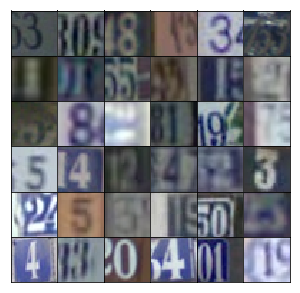

In [5]:
idx = np.random.randint(0, trainset['X'].shape[3], size=36)
fig, axes = plt.subplots(6, 6, sharex=True, sharey=True, figsize=(5,5),)
for ii, ax in zip(idx, axes.flatten()):
    ax.imshow(trainset['X'][:,:,:,ii], aspect='equal')
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)
plt.subplots_adjust(wspace=0, hspace=0)

Here we need to do a bit of preprocessing and getting the images into a form where we can pass batches to the network. First off, we need to rescale the images to a range of -1 to 1, since the output of our generator is also in that range. We also have a set of test and validation images which could be used if we're trying to identify the numbers in the images.

In [6]:
def scale(x, feature_range=(-1, 1)):
    # scale to (0, 1)
    x = ((x - x.min())/(255 - x.min()))
    
    # scale to feature_range
    min, max = feature_range
    x = x * (max - min) + min
    return x

In [7]:
class Dataset:
    def __init__(self, train, test, val_frac=0.5, shuffle=False, scale_func=None):
        split_idx = int(len(test['y'])*(1 - val_frac))
        self.test_x, self.valid_x = test['X'][:,:,:,:split_idx], test['X'][:,:,:,split_idx:]
        self.test_y, self.valid_y = test['y'][:split_idx], test['y'][split_idx:]
        self.train_x, self.train_y = train['X'], train['y']
        
        self.train_x = np.rollaxis(self.train_x, 3)
        self.valid_x = np.rollaxis(self.valid_x, 3)
        self.test_x = np.rollaxis(self.test_x, 3)
        
        if scale_func is None:
            self.scaler = scale
        else:
            self.scaler = scale_func
        self.shuffle = shuffle
        
    def batches(self, batch_size):
        if self.shuffle:
            idx = np.arange(len(dataset.train_x))
            np.random.shuffle(idx)
            self.train_x = self.train_x[idx]
            self.train_y = self.train_y[idx]
        
        n_batches = len(self.train_y)//batch_size
        for ii in range(0, len(self.train_y), batch_size):
            x = self.train_x[ii:ii+batch_size]
            y = self.train_y[ii:ii+batch_size]
            
            yield self.scaler(x), y

## Network Inputs

Here, just creating some placeholders like normal.

In [8]:
def model_inputs(real_dim, z_dim):
    inputs_real = tf.placeholder(tf.float32, (None, *real_dim), name='input_real')
    inputs_z = tf.placeholder(tf.float32, (None, z_dim), name='input_z')
    
    return inputs_real, inputs_z

## Generator

Here you'll build the generator network. The input will be our noise vector `z` as before. Also as before, the output will be a $tanh$ output, but this time with size 32x32 which is the size of our SVHN images.

What's new here is we'll use convolutional layers to create our new images. The first layer is a fully connected layer which is reshaped into a deep and narrow layer, something like 4x4x1024 as in the original DCGAN paper. Then we use batch normalization and a leaky ReLU activation. Next is a transposed convolution where typically you'd halve the depth and double the width and height of the previous layer. Again, we use batch normalization and leaky ReLU. For each of these layers, the general scheme is convolution > batch norm > leaky ReLU.

You keep stacking layers up like this until you get the final transposed convolution layer with shape 32x32x3. Below is the archicture used in the original DCGAN paper:

![DCGAN Generator](assets/dcgan.png)

Note that the final layer here is 64x64x3, while for our SVHN dataset, we only want it to be 32x32x3. 

>**Exercise:** Build the transposed convolutional network for the generator in the function below. Be sure to use leaky ReLUs on all the layers except for the last tanh layer, as well as batch normalization on all the transposed convolutional layers except the last one.

In [9]:
def batch_norm_transpose_conv(input_x, filters, training, kernel=3):
    
    batch = input_x.get_shape().as_list()[0]
    in_channels = input_x.get_shape().as_list()[3]
    out_channels = filters if filters else int(in_channels / 2)
    out_shape = np.array([batch, kernel, kernel, out_channels])
    
    weights = tf.Variable(tf.truncated_normal([kernel, kernel, out_channels, in_channels], stddev=0.05))
        
    gamma = tf.Variable(tf.ones(out_channels))
    beta = tf.Variable(tf.zeros(out_channels))
    
    pop_mean = tf.Variable(tf.zeros([out_channels]), trainable=False)
    pop_variance = tf.Variable(tf.zeros([out_channels]), trainable=False)
    
    epsilon = 1e-3
    
    # conv_transpose = tf.nn.conv2d_transpose(input_x, weights, out_shape, strides=[1,2,2,1], padding='SAME')
    conv_transpose = tf.layers.conv2d_transpose(input_x, filters, kernel_size=kernel, strides=(2, 2), padding='same')
    
    def batch_norm_training():
        decay = 0.99
        
        batch_mean, batch_variance = tf.nn.moments(conv_transpose, [0,1,2], keep_dims=False)
        
        train_mean = tf.assign(pop_mean, batch_mean * decay + pop_mean * (1 - decay))
        train_variance = tf.assign(pop_variance, batch_variance * decay + pop_variance * (1 - decay))
        
        with tf.control_dependencies([train_mean, train_variance]):
            return (conv_transpose - batch_mean) / tf.sqrt(batch_variance + epsilon)
    
    def batch_norm_inference():
        return (conv_transpose - pop_mean) / tf.sqrt(pop_variance + epsilon)
    
#     conv_transpose = tf.cond(training, batch_norm_training, batch_norm_inference)
    
    if training:
        conv_transpose = batch_norm_training()
    else:
        conv_transpose = batch_norm_inference()

    return gamma * conv_transpose + beta       

In [10]:
def lrelu(input_x, alpha):
            return tf.maximum(alpha * input_x, input_x)

In [11]:
def generator2(z, output_dim, training=True, reuse=False, alpha=0.2):
    with tf.variable_scope('generator', reuse=reuse):
        
        # First fully connected layer --> conv 4x4x512
        layer_1 = tf.layers.dense(z, 4*4*512, activation=None, use_bias=False)
        layer_1 = tf.reshape(layer_1, (-1,4,4,512))
        layer_1 = lrelu(layer_1, alpha)
        
        # Second conv layer 4x4x512 --> 8x8x256
        layer_2 = batch_norm_transpose_conv(layer_1, filters=256, training=training)
        layer_2 = lrelu(layer_2, alpha)
        
        # Third conv layer 8x8x256 --> 16x16x128
        layer_3 = batch_norm_transpose_conv(layer_2, filters=128, training=training)
        layer_3 = lrelu(layer_3, alpha)
        
        # Output layer, 32x32x3
        logits = batch_norm_transpose_conv(layer_3, filters=3, training=training)
        
        out = tf.tanh(logits)
        
        return out

In [12]:
def generator(z, output_dim, training=True, reuse=False, alpha=0.2):
    with tf.variable_scope('generator', reuse=reuse):
        
        # First fully connected layer --> conv 4x4x512
        layer_1 = tf.layers.dense(z, 4*4*512)
        layer_1 = tf.reshape(layer_1, (-1,4,4,512))
        layer_1 = tf.layers.batch_normalization(layer_1, training=training)
        layer_1 = lrelu(layer_1, alpha)
        
        # Second conv layer 4x4x512 --> 8x8x256
        layer_2 = tf.layers.conv2d_transpose(layer_1, 256, 5, strides=2, padding='same')
        layer_2 = tf.layers.batch_normalization(layer_2, training=training)
        layer_2 = lrelu(layer_2, alpha)
        
        # Third conv layer 8x8x256 --> 16x16x128
        layer_3 = tf.layers.conv2d_transpose(layer_2, 128, 5, strides=2, padding='same')
        layer_3 = tf.layers.batch_normalization(layer_3, training=training)
        layer_3 = lrelu(layer_3, alpha)
        
        # Output layer, 32x32x3
        logits = tf.layers.conv2d_transpose(layer_3, output_dim, 5, strides=2, padding='same')
        
        out = tf.tanh(logits)
        
        return out

## Discriminator

Here you'll build the discriminator. This is basically just a convolutional classifier like you've built before. The input to the discriminator are 32x32x3 tensors/images. You'll want a few convolutional layers, then a fully connected layer for the output. As before, we want a sigmoid output, and you'll need to return the logits as well. For the depths of the convolutional layers I suggest starting with 16, 32, 64 filters in the first layer, then double the depth as you add layers. Note that in the DCGAN paper, they did all the downsampling using only strided convolutional layers with no maxpool layers.

You'll also want to use batch normalization with `tf.layers.batch_normalization` on each layer except the first convolutional and output layers. Again, each layer should look something like convolution > batch norm > leaky ReLU.

Note: in this project, your batch normalization layers will always use batch statistics. (That is, always set `training` to `True`.) That's because we are only interested in using the discriminator to help train the generator. However, if you wanted to use the discriminator for inference later, then you would need to set the `training` parameter appropriately.

>**Exercise:** Build the convolutional network for the discriminator. The input is a 32x32x3 images, the output is a sigmoid plus the logits. Again, use Leaky ReLU activations and batch normalization on all the layers except the first.

In [13]:
def batch_norm_conv(input_x, filters, kernel=3):
    ''' 
    The discriminator will be always training, so there's no need to specify 1
    function for training and 1 for inference
    '''
    
    batch = input_x.get_shape().as_list()[0]
    in_channels = input_x.get_shape().as_list()[3]
    out_channels = filters if filters else in_channels * 2
    out_shape = [batch, kernel, kernel, out_channels]
    strides = [1, 2, 2, 1]
    
    weights = tf.Variable(tf.truncated_normal([kernel, kernel, in_channels, out_channels], stddev=0.05))
    
    conv_layer = tf.nn.conv2d(input_x,weights,strides,padding='SAME')
    
    gamma = tf.Variable(tf.ones([out_channels]))
    beta = tf.Variable(tf.ones([out_channels]))
    
    epsilon = 1e-3
    decay = 0.99
    
    batch_mean, batch_variance = tf.nn.moments(conv_layer, axes=[0,1,2], keep_dims=False)
    
    conv_layer = (conv_layer - batch_mean) / tf.sqrt(batch_variance + epsilon)
    return gamma * conv_layer + beta

In [14]:
def discriminator2(x, reuse=False, alpha=0.2):
    with tf.variable_scope('discriminator', reuse=reuse):
        # Input layer is 32x32x3 --> 16x16x64
        layer_1 = batch_norm_conv(x, filters=64)
        layer_1 = lrelu(layer_1, alpha)
        
        # Layer 2 16x16x64 --> 8x8x128
        layer_2 = batch_norm_conv(layer_1, filters=128)
        layer_2 = lrelu(layer_2, alpha)
        
        # Layer 3 8x8x128 --> 4x4x256
        layer_3 = batch_norm_conv(layer_2, filters=256)
        layer_3 = lrelu(layer_3, alpha)
        
        # Layer 4 4x4x256 --> 2x2x512
        layer_4 = batch_norm_conv(layer_3, filters=512)
        layer_4 = lrelu(layer_4, alpha)        
        
        # Makeing the layer flat fo use in the output
        flat = tf.reshape(layer_4, [-1, 2*2*512])
        
        logits = tf.layers.dense(flat, 1)
        out = tf.nn.sigmoid(logits)
        
        return out, logits

In [15]:
def discriminator(x, reuse=False, alpha=0.2):
    with tf.variable_scope('discriminator', reuse=reuse):
        # Input layer is 32x32x3 --> 16x16x64
        layer_1 = tf.layers.conv2d(x, 64, 5, strides=(2,2), padding='same')
        layer_1 = lrelu(layer_1, alpha)
        
        # Layer 2 16x16x64 --> 8x8x128
        layer_2 = tf.layers.conv2d(layer_1, 128, 5, strides=(2,2), padding='same')
        layer_2 = tf.layers.batch_normalization(layer_2, training=True)
        layer_2 = lrelu(layer_2, alpha)
        
        # Layer 3 8x8x128 --> 4x4x256
        layer_3 = tf.layers.conv2d(layer_2, 256, 5, strides=(2,2), padding='same')
        layer_3 = tf.layers.batch_normalization(layer_3, training=True)
        layer_3 = lrelu(layer_3, alpha)    
        
        # Makeing the layer flat fo use in the output
        flat = tf.reshape(layer_3, (-1, 4*4*256))
        
        logits = tf.layers.dense(flat, 1)
        out = tf.sigmoid(logits)
        
        return out, logits

## Model Loss

Calculating the loss like before, nothing new here.

In [16]:
def model_loss(input_real, input_z, output_dim, alpha=0.2):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    g_model = generator(input_z, output_dim, alpha=alpha)
    d_model_real, d_logits_real = discriminator(input_real, alpha=alpha)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True, alpha=alpha)

    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, labels=tf.ones_like(d_model_real)))
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_model_fake)))
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_model_fake)))

    d_loss = d_loss_real + d_loss_fake

    return d_loss, g_loss

## Optimizers

Not much new here, but notice how the train operations are wrapped in a `with tf.control_dependencies` block so the batch normalization layers can update their population statistics.

In [17]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # Get weights and bias to update
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]

    # Optimize
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt

## Building the model

Here we can use the functions we defined about to build the model as a class. This will make it easier to move the network around in our code since the nodes and operations in the graph are packaged in one object.

In [18]:
class GAN:
    def __init__(self, real_size, z_size, learning_rate, alpha=0.2, beta1=0.5):
        tf.reset_default_graph()
        
        self.input_real, self.input_z = model_inputs(real_size, z_size)
        
        self.d_loss, self.g_loss = model_loss(self.input_real, self.input_z,
                                              real_size[2], alpha=alpha)
        
        self.d_opt, self.g_opt = model_opt(self.d_loss, self.g_loss, learning_rate, beta1)

Here is a function for displaying generated images.

In [19]:
def view_samples(epoch, samples, nrows, ncols, figsize=(5,5)):
    fig, axes = plt.subplots(figsize=figsize, nrows=nrows, ncols=ncols, 
                             sharey=True, sharex=True)
    for ax, img in zip(axes.flatten(), samples[epoch]):
        ax.axis('off')
        img = ((img - img.min())*255 / (img.max() - img.min())).astype(np.uint8)
        ax.set_adjustable('box-forced')
        im = ax.imshow(img, aspect='equal')
   
    plt.subplots_adjust(wspace=0, hspace=0)
    return fig, axes

And another function we can use to train our network. Notice when we call `generator` to create the samples to display, we set `training` to `False`. That's so the batch normalization layers will use the population statistics rather than the batch statistics. Also notice that we set the `net.input_real` placeholder when we run the generator's optimizer. The generator doesn't actually use it, but we'd get an error without it because of the `tf.control_dependencies` block we created in `model_opt`. 

In [20]:
def train(net, dataset, epochs, batch_size, print_every=10, show_every=100, figsize=(5,5)):
    saver = tf.train.Saver()
    sample_z = np.random.uniform(-1, 1, size=(72, z_size))

    samples, losses = [], []
    steps = 0

    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for e in range(epochs):
            for x, y in dataset.batches(batch_size):
                steps += 1

                # Sample random noise for G
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_size))

                # Run optimizers
                _ = sess.run(net.d_opt, feed_dict={net.input_real: x, net.input_z: batch_z})
                _ = sess.run(net.g_opt, feed_dict={net.input_z: batch_z, net.input_real: x})

                if steps % print_every == 0:
                    # At the end of each epoch, get the losses and print them out
                    train_loss_d = net.d_loss.eval({net.input_z: batch_z, net.input_real: x})
                    train_loss_g = net.g_loss.eval({net.input_z: batch_z})

                    print("Epoch {}/{}...".format(e+1, epochs),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))
                    # Save losses to view after training
                    losses.append((train_loss_d, train_loss_g))

                if steps % show_every == 0:
                    gen_samples = sess.run(
                                   generator(net.input_z, 3, reuse=True, training=False),
                                   feed_dict={net.input_z: sample_z})
                    samples.append(gen_samples)
                    _ = view_samples(-1, samples, 6, 12, figsize=figsize)
                    plt.show()

        saver.save(sess, './checkpoints/generator.ckpt')

    with open('samples.pkl', 'wb') as f:
        pkl.dump(samples, f)
    
    return losses, samples

## Hyperparameters

GANs are very sensitive to hyperparameters. A lot of experimentation goes into finding the best hyperparameters such that the generator and discriminator don't overpower each other. Try out your own hyperparameters or read [the DCGAN paper](https://arxiv.org/pdf/1511.06434.pdf) to see what worked for them.

>**Exercise:** Find hyperparameters to train this GAN. The values found in the DCGAN paper work well, or you can experiment on your own. In general, you want the discriminator loss to be around 0.3, this means it is correctly classifying images as fake or real about 50% of the time.

In [21]:
real_size = (32,32,3)
z_size = 100
learning_rate = 0.0005
batch_size = 128
epochs = 20
alpha = 0.25
beta1 = 0.55

# Create the network
net = GAN(real_size, z_size, learning_rate, alpha=alpha, beta1=beta1)

Epoch 1/20... Discriminator Loss: 0.2482... Generator Loss: 7.5058
Epoch 1/20... Discriminator Loss: 0.0643... Generator Loss: 9.4647
Epoch 1/20... Discriminator Loss: 0.0213... Generator Loss: 5.5717
Epoch 1/20... Discriminator Loss: 0.0313... Generator Loss: 5.8202
Epoch 1/20... Discriminator Loss: 0.7633... Generator Loss: 0.8434
Epoch 1/20... Discriminator Loss: 0.8255... Generator Loss: 1.0871
Epoch 1/20... Discriminator Loss: 0.8164... Generator Loss: 1.4650
Epoch 1/20... Discriminator Loss: 0.8392... Generator Loss: 0.9408
Epoch 1/20... Discriminator Loss: 0.5533... Generator Loss: 1.3022
Epoch 1/20... Discriminator Loss: 0.2292... Generator Loss: 2.4967


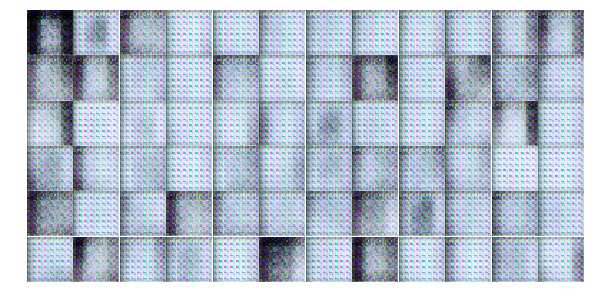

Epoch 1/20... Discriminator Loss: 0.3888... Generator Loss: 1.5472
Epoch 1/20... Discriminator Loss: 1.4864... Generator Loss: 0.6632
Epoch 1/20... Discriminator Loss: 0.5127... Generator Loss: 1.2323
Epoch 1/20... Discriminator Loss: 0.4019... Generator Loss: 2.1900
Epoch 1/20... Discriminator Loss: 1.0380... Generator Loss: 1.3593
Epoch 1/20... Discriminator Loss: 0.9154... Generator Loss: 1.0637
Epoch 1/20... Discriminator Loss: 0.8856... Generator Loss: 1.0590
Epoch 1/20... Discriminator Loss: 1.1168... Generator Loss: 1.6827
Epoch 1/20... Discriminator Loss: 0.8149... Generator Loss: 1.5535
Epoch 1/20... Discriminator Loss: 0.5067... Generator Loss: 1.4785


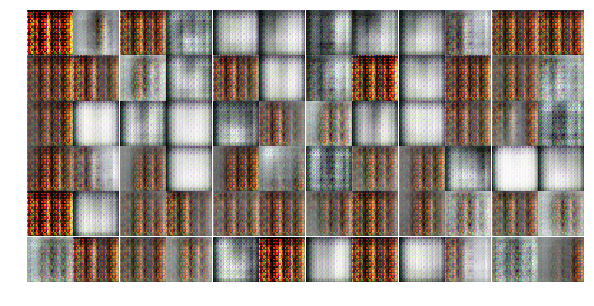

Epoch 1/20... Discriminator Loss: 0.8283... Generator Loss: 0.8398
Epoch 1/20... Discriminator Loss: 1.0336... Generator Loss: 1.5844
Epoch 1/20... Discriminator Loss: 1.0101... Generator Loss: 0.8896
Epoch 1/20... Discriminator Loss: 1.4686... Generator Loss: 0.5888
Epoch 1/20... Discriminator Loss: 0.6960... Generator Loss: 1.5575
Epoch 1/20... Discriminator Loss: 0.6038... Generator Loss: 2.6221
Epoch 1/20... Discriminator Loss: 0.9846... Generator Loss: 1.3171
Epoch 1/20... Discriminator Loss: 1.6003... Generator Loss: 5.4574
Epoch 1/20... Discriminator Loss: 0.8530... Generator Loss: 1.1232
Epoch 1/20... Discriminator Loss: 0.6861... Generator Loss: 1.8740


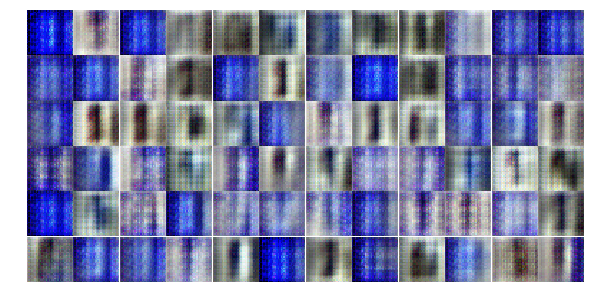

Epoch 1/20... Discriminator Loss: 0.6155... Generator Loss: 1.3904
Epoch 1/20... Discriminator Loss: 0.8463... Generator Loss: 0.9701
Epoch 1/20... Discriminator Loss: 1.5038... Generator Loss: 0.5185
Epoch 1/20... Discriminator Loss: 0.9565... Generator Loss: 1.3544
Epoch 1/20... Discriminator Loss: 1.0094... Generator Loss: 0.8320
Epoch 1/20... Discriminator Loss: 0.6448... Generator Loss: 1.5462
Epoch 1/20... Discriminator Loss: 0.8018... Generator Loss: 1.2981
Epoch 1/20... Discriminator Loss: 0.7085... Generator Loss: 1.7364
Epoch 1/20... Discriminator Loss: 0.7204... Generator Loss: 2.0258
Epoch 1/20... Discriminator Loss: 0.9201... Generator Loss: 1.0030


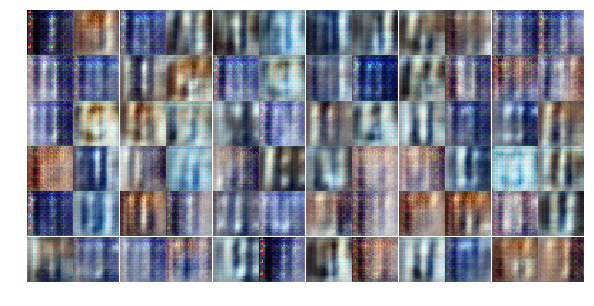

Epoch 1/20... Discriminator Loss: 1.2663... Generator Loss: 0.5744
Epoch 1/20... Discriminator Loss: 1.1750... Generator Loss: 0.7055
Epoch 1/20... Discriminator Loss: 0.8008... Generator Loss: 1.2121
Epoch 1/20... Discriminator Loss: 1.5679... Generator Loss: 2.0525
Epoch 1/20... Discriminator Loss: 1.3432... Generator Loss: 0.7556
Epoch 1/20... Discriminator Loss: 1.1314... Generator Loss: 1.0965
Epoch 1/20... Discriminator Loss: 1.5993... Generator Loss: 0.7777
Epoch 1/20... Discriminator Loss: 1.1077... Generator Loss: 1.0260
Epoch 1/20... Discriminator Loss: 0.9154... Generator Loss: 1.0749
Epoch 1/20... Discriminator Loss: 1.2617... Generator Loss: 1.0024


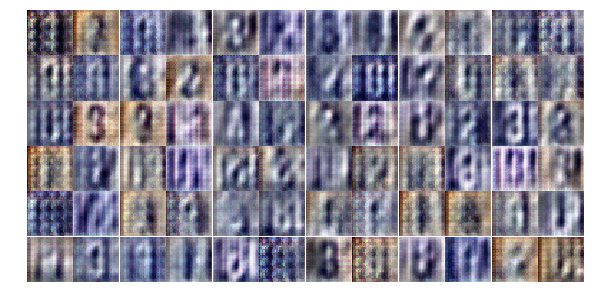

Epoch 1/20... Discriminator Loss: 0.9520... Generator Loss: 1.2806
Epoch 1/20... Discriminator Loss: 1.0779... Generator Loss: 0.8723
Epoch 1/20... Discriminator Loss: 0.8046... Generator Loss: 1.4360
Epoch 1/20... Discriminator Loss: 1.1420... Generator Loss: 0.6977
Epoch 1/20... Discriminator Loss: 1.1827... Generator Loss: 0.9208
Epoch 1/20... Discriminator Loss: 1.4007... Generator Loss: 0.7519
Epoch 1/20... Discriminator Loss: 1.3956... Generator Loss: 0.5750
Epoch 2/20... Discriminator Loss: 1.1686... Generator Loss: 1.3321
Epoch 2/20... Discriminator Loss: 1.2261... Generator Loss: 0.9407
Epoch 2/20... Discriminator Loss: 1.6917... Generator Loss: 0.3708


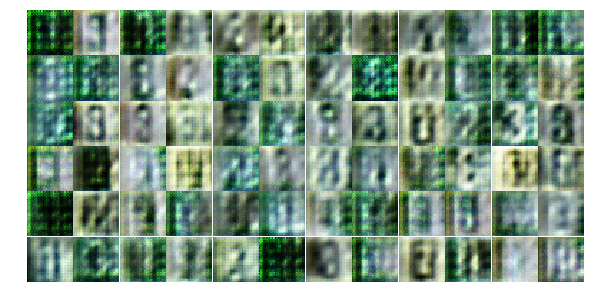

Epoch 2/20... Discriminator Loss: 1.2326... Generator Loss: 0.9117
Epoch 2/20... Discriminator Loss: 1.1584... Generator Loss: 1.4502
Epoch 2/20... Discriminator Loss: 0.7183... Generator Loss: 1.2885
Epoch 2/20... Discriminator Loss: 0.8793... Generator Loss: 1.1482
Epoch 2/20... Discriminator Loss: 0.8933... Generator Loss: 1.0939
Epoch 2/20... Discriminator Loss: 0.6382... Generator Loss: 1.4521
Epoch 2/20... Discriminator Loss: 0.8853... Generator Loss: 1.1995
Epoch 2/20... Discriminator Loss: 1.2882... Generator Loss: 0.8268
Epoch 2/20... Discriminator Loss: 1.4379... Generator Loss: 0.6290
Epoch 2/20... Discriminator Loss: 1.3685... Generator Loss: 0.7140


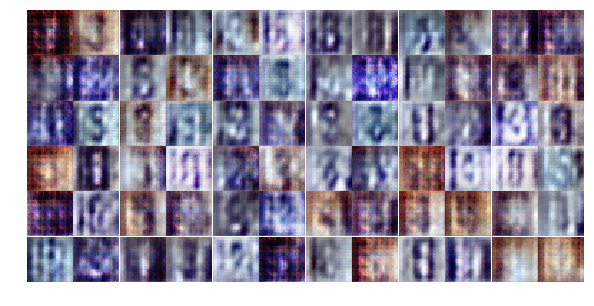

Epoch 2/20... Discriminator Loss: 1.1318... Generator Loss: 0.9676
Epoch 2/20... Discriminator Loss: 1.3171... Generator Loss: 0.6673
Epoch 2/20... Discriminator Loss: 1.5090... Generator Loss: 0.7868
Epoch 2/20... Discriminator Loss: 1.3187... Generator Loss: 0.7823
Epoch 2/20... Discriminator Loss: 1.1663... Generator Loss: 1.0019
Epoch 2/20... Discriminator Loss: 1.0860... Generator Loss: 0.8962
Epoch 2/20... Discriminator Loss: 1.1772... Generator Loss: 0.7297
Epoch 2/20... Discriminator Loss: 0.8163... Generator Loss: 1.1908
Epoch 2/20... Discriminator Loss: 1.1901... Generator Loss: 0.9145
Epoch 2/20... Discriminator Loss: 1.2475... Generator Loss: 0.6860


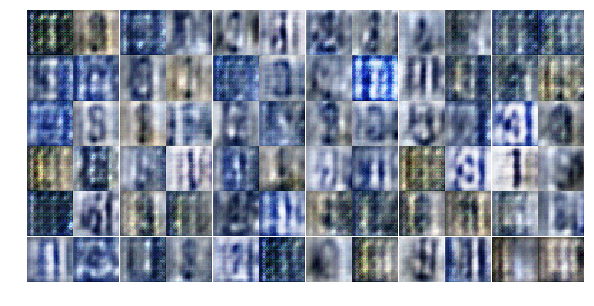

Epoch 2/20... Discriminator Loss: 1.0303... Generator Loss: 0.9046
Epoch 2/20... Discriminator Loss: 1.1330... Generator Loss: 1.0825
Epoch 2/20... Discriminator Loss: 0.7667... Generator Loss: 2.2236
Epoch 2/20... Discriminator Loss: 1.5091... Generator Loss: 0.6027
Epoch 2/20... Discriminator Loss: 1.0764... Generator Loss: 1.3164
Epoch 2/20... Discriminator Loss: 0.9524... Generator Loss: 1.0700
Epoch 2/20... Discriminator Loss: 1.1023... Generator Loss: 0.9157
Epoch 2/20... Discriminator Loss: 1.4704... Generator Loss: 0.8716
Epoch 2/20... Discriminator Loss: 1.1623... Generator Loss: 0.9618
Epoch 2/20... Discriminator Loss: 1.0044... Generator Loss: 1.0043


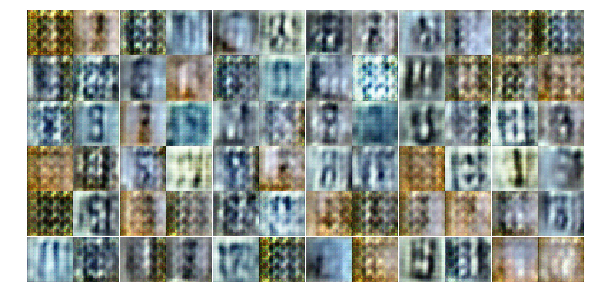

Epoch 2/20... Discriminator Loss: 1.4975... Generator Loss: 0.6263
Epoch 2/20... Discriminator Loss: 1.2382... Generator Loss: 0.8254
Epoch 2/20... Discriminator Loss: 1.2940... Generator Loss: 0.8600
Epoch 2/20... Discriminator Loss: 1.2740... Generator Loss: 0.8393
Epoch 2/20... Discriminator Loss: 1.1939... Generator Loss: 0.8677
Epoch 2/20... Discriminator Loss: 1.1750... Generator Loss: 0.8460
Epoch 2/20... Discriminator Loss: 1.0399... Generator Loss: 1.0229
Epoch 2/20... Discriminator Loss: 1.0721... Generator Loss: 1.4962
Epoch 2/20... Discriminator Loss: 1.1972... Generator Loss: 1.1101
Epoch 2/20... Discriminator Loss: 1.1661... Generator Loss: 1.0119


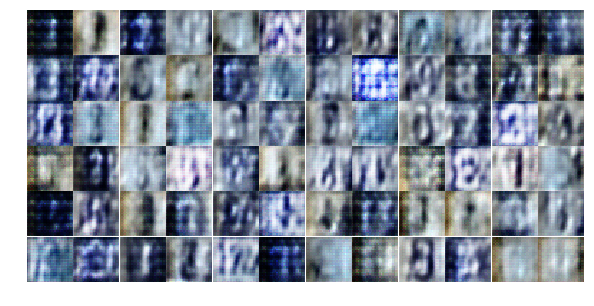

Epoch 2/20... Discriminator Loss: 1.0604... Generator Loss: 1.1453
Epoch 2/20... Discriminator Loss: 0.9138... Generator Loss: 0.8903
Epoch 2/20... Discriminator Loss: 1.3525... Generator Loss: 0.6842
Epoch 2/20... Discriminator Loss: 1.3786... Generator Loss: 0.7056
Epoch 2/20... Discriminator Loss: 1.3572... Generator Loss: 0.9594
Epoch 2/20... Discriminator Loss: 1.4368... Generator Loss: 0.4715
Epoch 2/20... Discriminator Loss: 1.0274... Generator Loss: 1.0821
Epoch 2/20... Discriminator Loss: 1.1636... Generator Loss: 1.4888
Epoch 2/20... Discriminator Loss: 1.4932... Generator Loss: 0.7008
Epoch 2/20... Discriminator Loss: 0.9852... Generator Loss: 1.1501


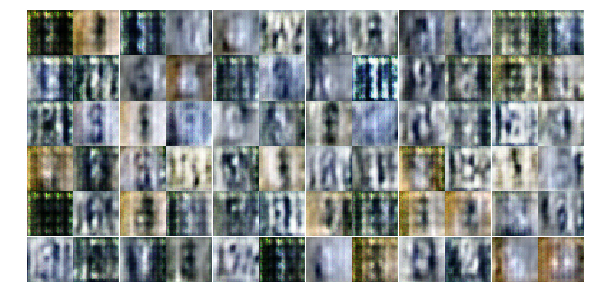

Epoch 2/20... Discriminator Loss: 1.3184... Generator Loss: 0.9945
Epoch 2/20... Discriminator Loss: 1.0199... Generator Loss: 1.1057
Epoch 2/20... Discriminator Loss: 1.2209... Generator Loss: 0.8081
Epoch 2/20... Discriminator Loss: 1.2072... Generator Loss: 0.8690
Epoch 3/20... Discriminator Loss: 1.2095... Generator Loss: 1.5104
Epoch 3/20... Discriminator Loss: 1.1489... Generator Loss: 0.9803
Epoch 3/20... Discriminator Loss: 1.4343... Generator Loss: 0.7722
Epoch 3/20... Discriminator Loss: 1.2064... Generator Loss: 0.9798
Epoch 3/20... Discriminator Loss: 1.3538... Generator Loss: 0.5861
Epoch 3/20... Discriminator Loss: 1.1821... Generator Loss: 0.8177


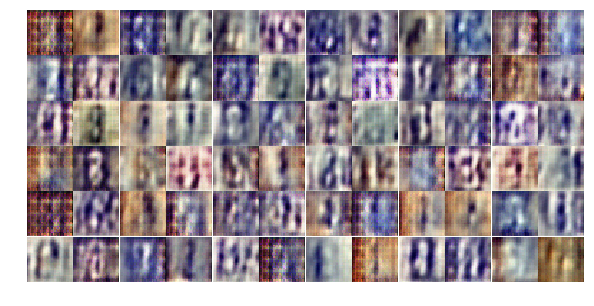

Epoch 3/20... Discriminator Loss: 1.6618... Generator Loss: 1.0083
Epoch 3/20... Discriminator Loss: 1.6399... Generator Loss: 0.3128
Epoch 3/20... Discriminator Loss: 1.0073... Generator Loss: 0.9446
Epoch 3/20... Discriminator Loss: 1.3337... Generator Loss: 1.0512
Epoch 3/20... Discriminator Loss: 1.6236... Generator Loss: 0.4501
Epoch 3/20... Discriminator Loss: 1.3035... Generator Loss: 0.7629
Epoch 3/20... Discriminator Loss: 1.3334... Generator Loss: 0.8385
Epoch 3/20... Discriminator Loss: 1.2656... Generator Loss: 0.8895
Epoch 3/20... Discriminator Loss: 1.6347... Generator Loss: 0.4906
Epoch 3/20... Discriminator Loss: 1.4272... Generator Loss: 0.7042


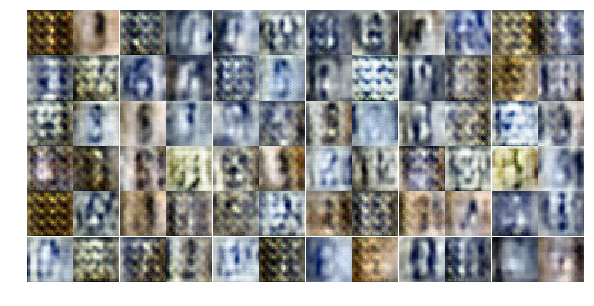

Epoch 3/20... Discriminator Loss: 1.1594... Generator Loss: 0.9243
Epoch 3/20... Discriminator Loss: 1.2370... Generator Loss: 0.7903
Epoch 3/20... Discriminator Loss: 1.3328... Generator Loss: 0.7369
Epoch 3/20... Discriminator Loss: 1.1848... Generator Loss: 0.9885
Epoch 3/20... Discriminator Loss: 1.1925... Generator Loss: 0.8469
Epoch 3/20... Discriminator Loss: 1.2941... Generator Loss: 0.8375
Epoch 3/20... Discriminator Loss: 1.4869... Generator Loss: 0.7312
Epoch 3/20... Discriminator Loss: 1.3725... Generator Loss: 0.5658
Epoch 3/20... Discriminator Loss: 1.0280... Generator Loss: 0.8977
Epoch 3/20... Discriminator Loss: 1.1888... Generator Loss: 0.9080


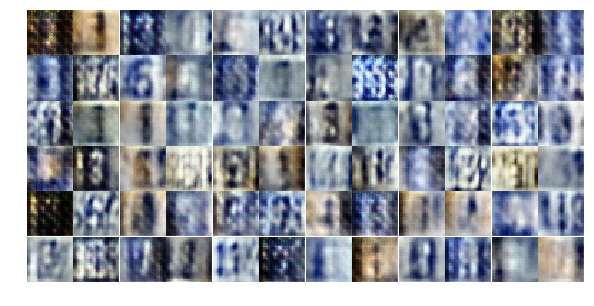

Epoch 3/20... Discriminator Loss: 1.2267... Generator Loss: 0.9394
Epoch 3/20... Discriminator Loss: 1.2832... Generator Loss: 0.8247
Epoch 3/20... Discriminator Loss: 1.2244... Generator Loss: 0.8009
Epoch 3/20... Discriminator Loss: 1.4742... Generator Loss: 0.6417
Epoch 3/20... Discriminator Loss: 1.2320... Generator Loss: 0.9827
Epoch 3/20... Discriminator Loss: 1.2206... Generator Loss: 0.8644
Epoch 3/20... Discriminator Loss: 1.2939... Generator Loss: 1.0660
Epoch 3/20... Discriminator Loss: 1.3370... Generator Loss: 0.8191
Epoch 3/20... Discriminator Loss: 1.1654... Generator Loss: 0.9963
Epoch 3/20... Discriminator Loss: 1.2625... Generator Loss: 0.6800


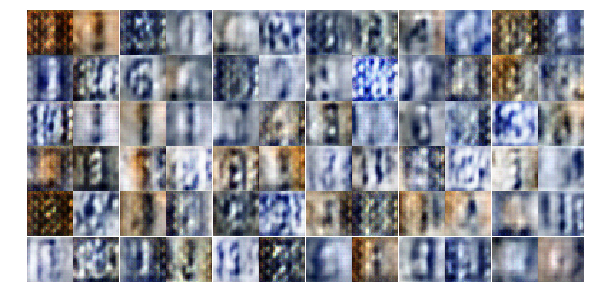

Epoch 3/20... Discriminator Loss: 1.1625... Generator Loss: 0.8616
Epoch 3/20... Discriminator Loss: 1.2562... Generator Loss: 0.7529
Epoch 3/20... Discriminator Loss: 1.2148... Generator Loss: 0.8673
Epoch 3/20... Discriminator Loss: 1.2449... Generator Loss: 0.9413
Epoch 3/20... Discriminator Loss: 1.2401... Generator Loss: 0.9447
Epoch 3/20... Discriminator Loss: 1.1122... Generator Loss: 0.7306
Epoch 3/20... Discriminator Loss: 1.7546... Generator Loss: 0.6426
Epoch 3/20... Discriminator Loss: 1.3786... Generator Loss: 0.8021
Epoch 3/20... Discriminator Loss: 1.2257... Generator Loss: 0.9665
Epoch 3/20... Discriminator Loss: 1.3740... Generator Loss: 0.6985


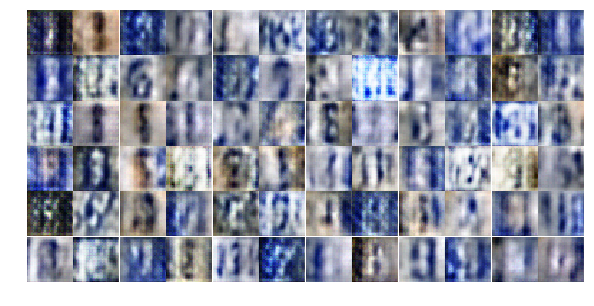

Epoch 3/20... Discriminator Loss: 1.2519... Generator Loss: 0.9231
Epoch 3/20... Discriminator Loss: 1.1652... Generator Loss: 0.7660
Epoch 3/20... Discriminator Loss: 1.2139... Generator Loss: 0.8654
Epoch 3/20... Discriminator Loss: 1.3078... Generator Loss: 0.8165
Epoch 3/20... Discriminator Loss: 1.1516... Generator Loss: 0.9041
Epoch 3/20... Discriminator Loss: 1.1726... Generator Loss: 0.7958
Epoch 3/20... Discriminator Loss: 1.1160... Generator Loss: 0.9327
Epoch 3/20... Discriminator Loss: 1.0335... Generator Loss: 1.1539
Epoch 3/20... Discriminator Loss: 1.2643... Generator Loss: 0.8160
Epoch 3/20... Discriminator Loss: 1.3371... Generator Loss: 0.9219


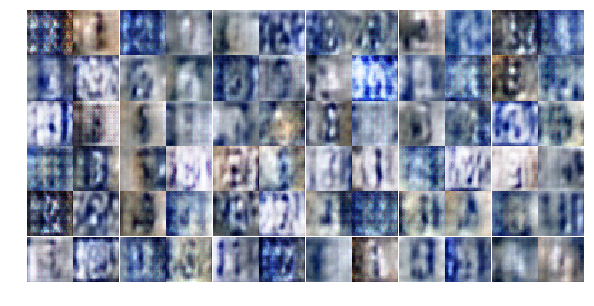

Epoch 3/20... Discriminator Loss: 1.5944... Generator Loss: 0.5518
Epoch 4/20... Discriminator Loss: 1.2748... Generator Loss: 0.6827
Epoch 4/20... Discriminator Loss: 1.3152... Generator Loss: 0.9528
Epoch 4/20... Discriminator Loss: 0.7976... Generator Loss: 1.1392
Epoch 4/20... Discriminator Loss: 1.2172... Generator Loss: 0.9614
Epoch 4/20... Discriminator Loss: 1.2638... Generator Loss: 1.1074
Epoch 4/20... Discriminator Loss: 1.3541... Generator Loss: 0.5395
Epoch 4/20... Discriminator Loss: 1.4000... Generator Loss: 0.6675
Epoch 4/20... Discriminator Loss: 1.1795... Generator Loss: 0.9255
Epoch 4/20... Discriminator Loss: 1.2444... Generator Loss: 0.8448


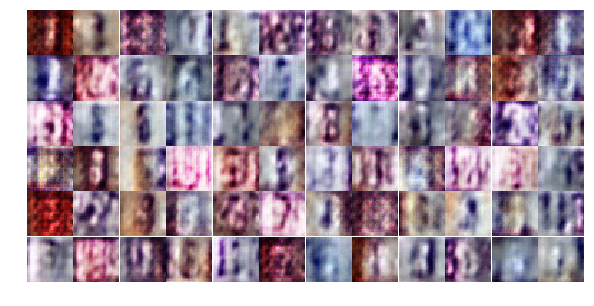

Epoch 4/20... Discriminator Loss: 1.1677... Generator Loss: 0.6900
Epoch 4/20... Discriminator Loss: 1.1160... Generator Loss: 0.8295
Epoch 4/20... Discriminator Loss: 1.2062... Generator Loss: 1.0249
Epoch 4/20... Discriminator Loss: 1.1790... Generator Loss: 0.8804
Epoch 4/20... Discriminator Loss: 1.0028... Generator Loss: 0.8768
Epoch 4/20... Discriminator Loss: 1.3067... Generator Loss: 0.4378
Epoch 4/20... Discriminator Loss: 1.3633... Generator Loss: 0.5338
Epoch 4/20... Discriminator Loss: 0.9755... Generator Loss: 1.0059
Epoch 4/20... Discriminator Loss: 1.2444... Generator Loss: 0.7067
Epoch 4/20... Discriminator Loss: 0.8051... Generator Loss: 1.2839


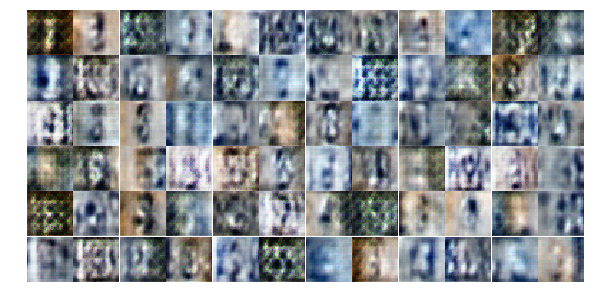

Epoch 4/20... Discriminator Loss: 1.1036... Generator Loss: 1.3146
Epoch 4/20... Discriminator Loss: 0.9865... Generator Loss: 1.0055
Epoch 4/20... Discriminator Loss: 0.8732... Generator Loss: 1.3560
Epoch 4/20... Discriminator Loss: 1.1777... Generator Loss: 0.9099
Epoch 4/20... Discriminator Loss: 0.7455... Generator Loss: 1.2372
Epoch 4/20... Discriminator Loss: 1.0282... Generator Loss: 1.2838
Epoch 4/20... Discriminator Loss: 1.2997... Generator Loss: 0.6582
Epoch 4/20... Discriminator Loss: 0.8796... Generator Loss: 1.0455
Epoch 4/20... Discriminator Loss: 0.8856... Generator Loss: 1.2858
Epoch 4/20... Discriminator Loss: 0.9187... Generator Loss: 1.0087


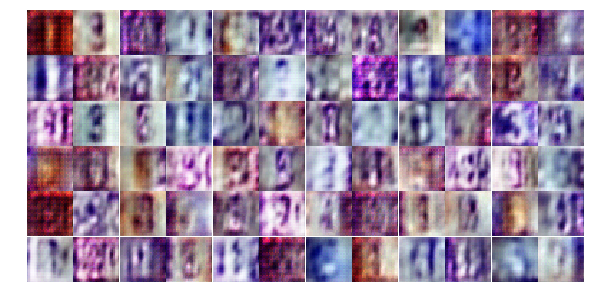

Epoch 4/20... Discriminator Loss: 0.9925... Generator Loss: 0.9203
Epoch 4/20... Discriminator Loss: 1.2816... Generator Loss: 0.5517
Epoch 4/20... Discriminator Loss: 0.9850... Generator Loss: 1.1867
Epoch 4/20... Discriminator Loss: 0.8193... Generator Loss: 1.5231
Epoch 4/20... Discriminator Loss: 0.8707... Generator Loss: 1.4045
Epoch 4/20... Discriminator Loss: 0.9274... Generator Loss: 1.1499
Epoch 4/20... Discriminator Loss: 1.1297... Generator Loss: 0.7867
Epoch 4/20... Discriminator Loss: 0.7586... Generator Loss: 0.9436
Epoch 4/20... Discriminator Loss: 1.1411... Generator Loss: 0.5235
Epoch 4/20... Discriminator Loss: 0.9436... Generator Loss: 0.8833


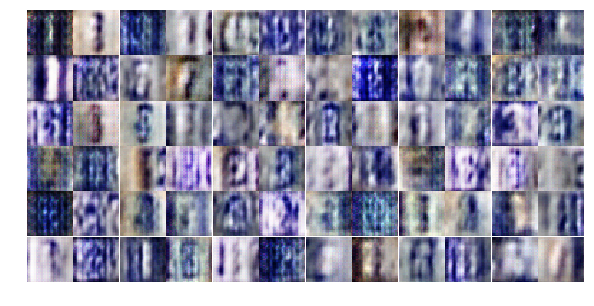

Epoch 4/20... Discriminator Loss: 0.7535... Generator Loss: 1.1559
Epoch 4/20... Discriminator Loss: 0.7426... Generator Loss: 1.1836
Epoch 4/20... Discriminator Loss: 0.9222... Generator Loss: 1.2211
Epoch 4/20... Discriminator Loss: 0.8407... Generator Loss: 0.8822
Epoch 4/20... Discriminator Loss: 1.5449... Generator Loss: 1.2259
Epoch 4/20... Discriminator Loss: 1.5051... Generator Loss: 0.4916
Epoch 4/20... Discriminator Loss: 1.0912... Generator Loss: 1.2971
Epoch 4/20... Discriminator Loss: 0.9457... Generator Loss: 1.0403
Epoch 4/20... Discriminator Loss: 0.7994... Generator Loss: 0.9496
Epoch 4/20... Discriminator Loss: 1.0621... Generator Loss: 1.9032


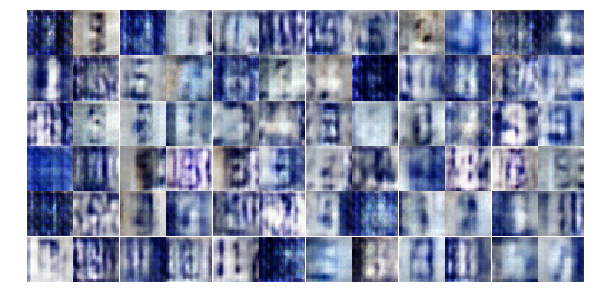

Epoch 4/20... Discriminator Loss: 0.8578... Generator Loss: 1.4805
Epoch 4/20... Discriminator Loss: 0.8560... Generator Loss: 1.0350
Epoch 4/20... Discriminator Loss: 0.7065... Generator Loss: 1.4726
Epoch 4/20... Discriminator Loss: 0.6836... Generator Loss: 1.3948
Epoch 4/20... Discriminator Loss: 1.1834... Generator Loss: 0.6309
Epoch 4/20... Discriminator Loss: 0.9874... Generator Loss: 0.7854
Epoch 4/20... Discriminator Loss: 0.6986... Generator Loss: 1.2498
Epoch 4/20... Discriminator Loss: 0.8423... Generator Loss: 1.9171
Epoch 4/20... Discriminator Loss: 0.7605... Generator Loss: 1.2639
Epoch 5/20... Discriminator Loss: 0.6973... Generator Loss: 1.4549


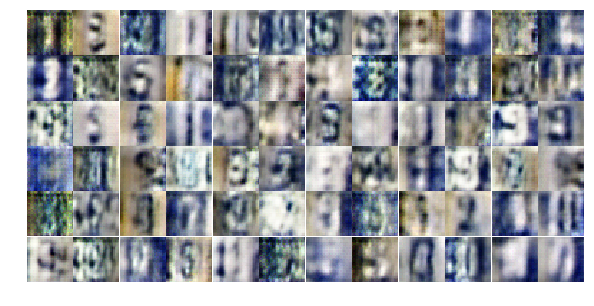

Epoch 5/20... Discriminator Loss: 0.8883... Generator Loss: 0.9029
Epoch 5/20... Discriminator Loss: 0.8026... Generator Loss: 1.3685
Epoch 5/20... Discriminator Loss: 0.8990... Generator Loss: 0.8076
Epoch 5/20... Discriminator Loss: 1.5172... Generator Loss: 0.3925
Epoch 5/20... Discriminator Loss: 0.7426... Generator Loss: 1.1452
Epoch 5/20... Discriminator Loss: 1.0777... Generator Loss: 1.0262
Epoch 5/20... Discriminator Loss: 0.8575... Generator Loss: 1.3954
Epoch 5/20... Discriminator Loss: 0.9373... Generator Loss: 0.8774
Epoch 5/20... Discriminator Loss: 1.0378... Generator Loss: 2.0688
Epoch 5/20... Discriminator Loss: 1.3847... Generator Loss: 0.6310


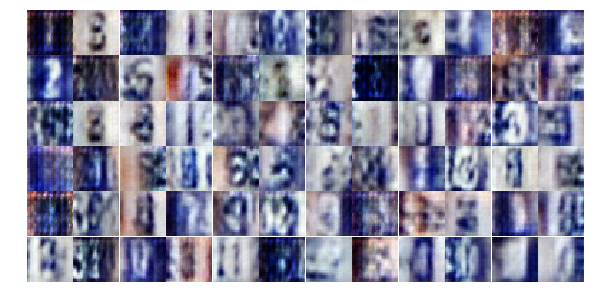

Epoch 5/20... Discriminator Loss: 0.9702... Generator Loss: 0.7863
Epoch 5/20... Discriminator Loss: 0.9119... Generator Loss: 0.9617
Epoch 5/20... Discriminator Loss: 1.0410... Generator Loss: 0.9739
Epoch 5/20... Discriminator Loss: 2.0789... Generator Loss: 0.2164
Epoch 5/20... Discriminator Loss: 1.1103... Generator Loss: 0.8262
Epoch 5/20... Discriminator Loss: 1.1548... Generator Loss: 0.8571
Epoch 5/20... Discriminator Loss: 0.9031... Generator Loss: 0.9103
Epoch 5/20... Discriminator Loss: 1.0522... Generator Loss: 0.8482
Epoch 5/20... Discriminator Loss: 0.8436... Generator Loss: 1.2926
Epoch 5/20... Discriminator Loss: 0.8737... Generator Loss: 0.9525


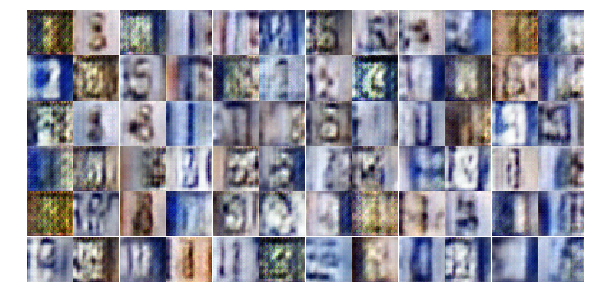

Epoch 5/20... Discriminator Loss: 0.9731... Generator Loss: 0.9975
Epoch 5/20... Discriminator Loss: 1.2636... Generator Loss: 0.6326
Epoch 5/20... Discriminator Loss: 0.9526... Generator Loss: 1.7417
Epoch 5/20... Discriminator Loss: 1.0165... Generator Loss: 0.8054
Epoch 5/20... Discriminator Loss: 0.9449... Generator Loss: 0.7795
Epoch 5/20... Discriminator Loss: 1.0152... Generator Loss: 0.7014
Epoch 5/20... Discriminator Loss: 1.5147... Generator Loss: 0.3564
Epoch 5/20... Discriminator Loss: 1.0585... Generator Loss: 0.9534
Epoch 5/20... Discriminator Loss: 0.8981... Generator Loss: 1.1688
Epoch 5/20... Discriminator Loss: 1.2009... Generator Loss: 2.1648


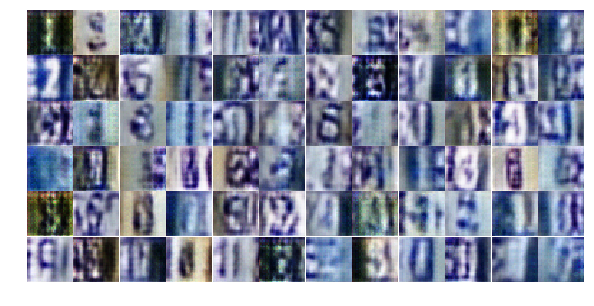

Epoch 5/20... Discriminator Loss: 1.1352... Generator Loss: 1.2829
Epoch 5/20... Discriminator Loss: 1.5110... Generator Loss: 2.4788
Epoch 5/20... Discriminator Loss: 0.8789... Generator Loss: 1.1225
Epoch 5/20... Discriminator Loss: 0.8900... Generator Loss: 1.4175
Epoch 5/20... Discriminator Loss: 0.9718... Generator Loss: 0.8315
Epoch 5/20... Discriminator Loss: 1.0775... Generator Loss: 1.3923
Epoch 5/20... Discriminator Loss: 1.1375... Generator Loss: 0.7126
Epoch 5/20... Discriminator Loss: 1.3012... Generator Loss: 0.5376
Epoch 5/20... Discriminator Loss: 1.0377... Generator Loss: 0.7101
Epoch 5/20... Discriminator Loss: 1.1331... Generator Loss: 0.5758


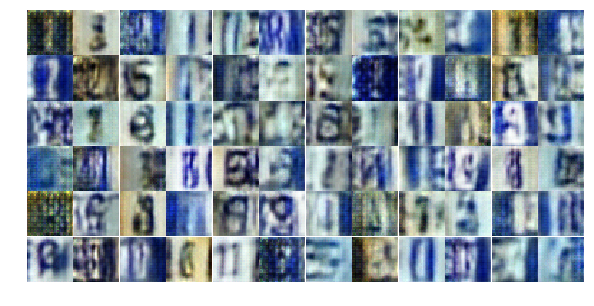

Epoch 5/20... Discriminator Loss: 0.7763... Generator Loss: 1.2329
Epoch 5/20... Discriminator Loss: 0.9208... Generator Loss: 0.8242
Epoch 5/20... Discriminator Loss: 1.0975... Generator Loss: 1.3382
Epoch 5/20... Discriminator Loss: 0.7573... Generator Loss: 1.1662
Epoch 5/20... Discriminator Loss: 1.0125... Generator Loss: 1.8365
Epoch 5/20... Discriminator Loss: 1.1068... Generator Loss: 1.1689
Epoch 5/20... Discriminator Loss: 1.1195... Generator Loss: 1.1590
Epoch 5/20... Discriminator Loss: 1.3140... Generator Loss: 2.5345
Epoch 5/20... Discriminator Loss: 1.1934... Generator Loss: 0.4844
Epoch 5/20... Discriminator Loss: 1.0335... Generator Loss: 1.2003


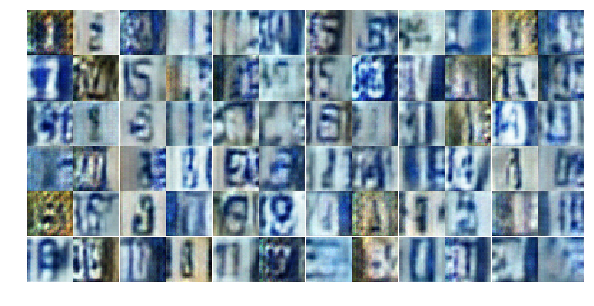

Epoch 5/20... Discriminator Loss: 1.4040... Generator Loss: 0.4431
Epoch 5/20... Discriminator Loss: 1.0579... Generator Loss: 0.7707
Epoch 5/20... Discriminator Loss: 1.3526... Generator Loss: 0.4848
Epoch 5/20... Discriminator Loss: 0.9725... Generator Loss: 0.8206
Epoch 5/20... Discriminator Loss: 0.9179... Generator Loss: 1.2873
Epoch 5/20... Discriminator Loss: 1.3418... Generator Loss: 0.5137
Epoch 6/20... Discriminator Loss: 1.1947... Generator Loss: 0.5482
Epoch 6/20... Discriminator Loss: 0.9716... Generator Loss: 0.9389
Epoch 6/20... Discriminator Loss: 1.1279... Generator Loss: 1.0785
Epoch 6/20... Discriminator Loss: 1.1472... Generator Loss: 0.9130


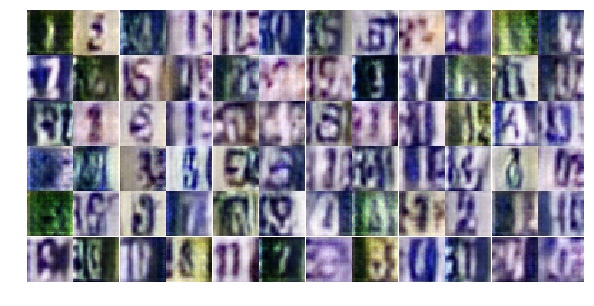

Epoch 6/20... Discriminator Loss: 1.0596... Generator Loss: 0.7624
Epoch 6/20... Discriminator Loss: 1.2480... Generator Loss: 0.5280
Epoch 6/20... Discriminator Loss: 0.7426... Generator Loss: 1.7432
Epoch 6/20... Discriminator Loss: 1.2073... Generator Loss: 0.5335
Epoch 6/20... Discriminator Loss: 1.0713... Generator Loss: 0.6837
Epoch 6/20... Discriminator Loss: 1.0736... Generator Loss: 0.6125
Epoch 6/20... Discriminator Loss: 0.8826... Generator Loss: 1.1204
Epoch 6/20... Discriminator Loss: 1.1948... Generator Loss: 0.6543
Epoch 6/20... Discriminator Loss: 0.9212... Generator Loss: 1.3764
Epoch 6/20... Discriminator Loss: 1.0446... Generator Loss: 0.9206


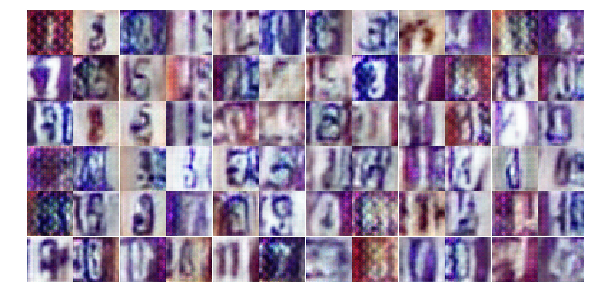

Epoch 6/20... Discriminator Loss: 0.9545... Generator Loss: 0.8519
Epoch 6/20... Discriminator Loss: 1.1298... Generator Loss: 0.6604
Epoch 6/20... Discriminator Loss: 1.1823... Generator Loss: 0.7245
Epoch 6/20... Discriminator Loss: 0.9174... Generator Loss: 0.8066
Epoch 6/20... Discriminator Loss: 0.5918... Generator Loss: 1.6116
Epoch 6/20... Discriminator Loss: 0.8494... Generator Loss: 1.1313
Epoch 6/20... Discriminator Loss: 0.7869... Generator Loss: 0.9981
Epoch 6/20... Discriminator Loss: 1.0470... Generator Loss: 0.6042
Epoch 6/20... Discriminator Loss: 0.9398... Generator Loss: 1.4090
Epoch 6/20... Discriminator Loss: 1.2659... Generator Loss: 0.5911


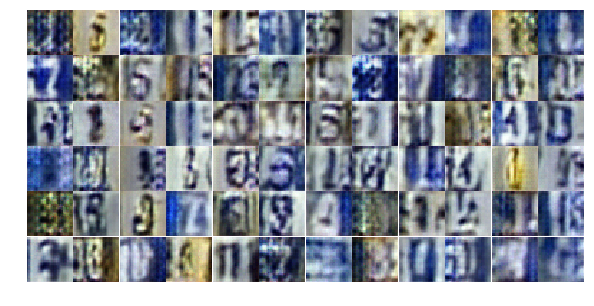

Epoch 6/20... Discriminator Loss: 1.0754... Generator Loss: 0.6846
Epoch 6/20... Discriminator Loss: 1.0497... Generator Loss: 0.7706
Epoch 6/20... Discriminator Loss: 1.1698... Generator Loss: 0.6716
Epoch 6/20... Discriminator Loss: 1.1215... Generator Loss: 0.5993
Epoch 6/20... Discriminator Loss: 0.9128... Generator Loss: 1.8458
Epoch 6/20... Discriminator Loss: 1.0087... Generator Loss: 1.2594
Epoch 6/20... Discriminator Loss: 1.1383... Generator Loss: 0.7386
Epoch 6/20... Discriminator Loss: 0.7866... Generator Loss: 1.1480
Epoch 6/20... Discriminator Loss: 0.7444... Generator Loss: 1.1401
Epoch 6/20... Discriminator Loss: 0.9689... Generator Loss: 1.5089


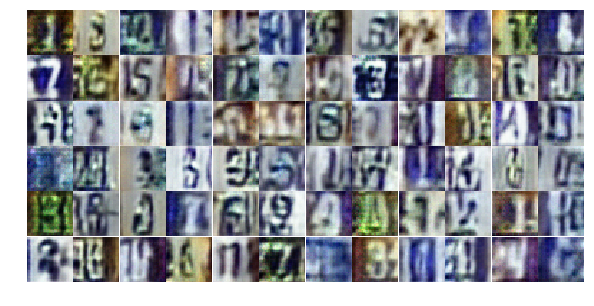

Epoch 6/20... Discriminator Loss: 1.3132... Generator Loss: 0.4415
Epoch 6/20... Discriminator Loss: 1.2836... Generator Loss: 1.3855
Epoch 6/20... Discriminator Loss: 1.1223... Generator Loss: 0.7444
Epoch 6/20... Discriminator Loss: 0.9865... Generator Loss: 0.6854
Epoch 6/20... Discriminator Loss: 1.1117... Generator Loss: 0.6121
Epoch 6/20... Discriminator Loss: 1.0689... Generator Loss: 0.8244
Epoch 6/20... Discriminator Loss: 0.7938... Generator Loss: 1.1194
Epoch 6/20... Discriminator Loss: 1.3970... Generator Loss: 2.9671
Epoch 6/20... Discriminator Loss: 1.1365... Generator Loss: 0.6380
Epoch 6/20... Discriminator Loss: 0.8099... Generator Loss: 0.8342


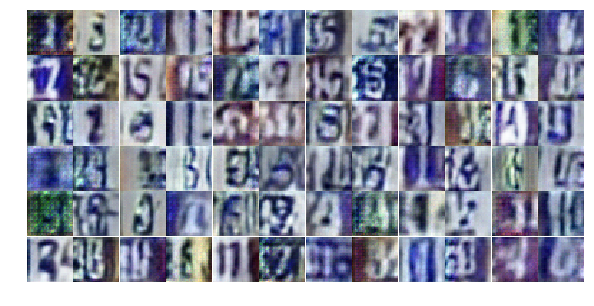

Epoch 6/20... Discriminator Loss: 1.0730... Generator Loss: 1.3117
Epoch 6/20... Discriminator Loss: 0.7547... Generator Loss: 1.1289
Epoch 6/20... Discriminator Loss: 1.2462... Generator Loss: 0.7236
Epoch 6/20... Discriminator Loss: 1.2431... Generator Loss: 1.8893
Epoch 6/20... Discriminator Loss: 1.1037... Generator Loss: 0.6607
Epoch 6/20... Discriminator Loss: 0.8717... Generator Loss: 1.1339
Epoch 6/20... Discriminator Loss: 1.2284... Generator Loss: 0.5796
Epoch 6/20... Discriminator Loss: 0.9996... Generator Loss: 0.6622
Epoch 6/20... Discriminator Loss: 1.1684... Generator Loss: 0.5885
Epoch 6/20... Discriminator Loss: 1.5091... Generator Loss: 0.3659


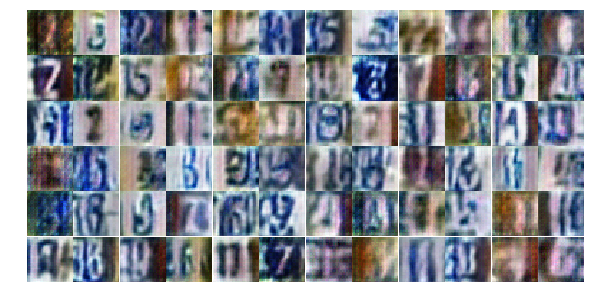

Epoch 6/20... Discriminator Loss: 1.2352... Generator Loss: 1.0077
Epoch 6/20... Discriminator Loss: 0.7506... Generator Loss: 1.4190
Epoch 6/20... Discriminator Loss: 1.1904... Generator Loss: 0.7396
Epoch 7/20... Discriminator Loss: 1.1890... Generator Loss: 1.0560
Epoch 7/20... Discriminator Loss: 0.7457... Generator Loss: 1.1920
Epoch 7/20... Discriminator Loss: 1.2087... Generator Loss: 0.5817
Epoch 7/20... Discriminator Loss: 0.8542... Generator Loss: 0.8738
Epoch 7/20... Discriminator Loss: 1.0527... Generator Loss: 0.8523
Epoch 7/20... Discriminator Loss: 1.4410... Generator Loss: 1.7976
Epoch 7/20... Discriminator Loss: 1.2452... Generator Loss: 0.8933


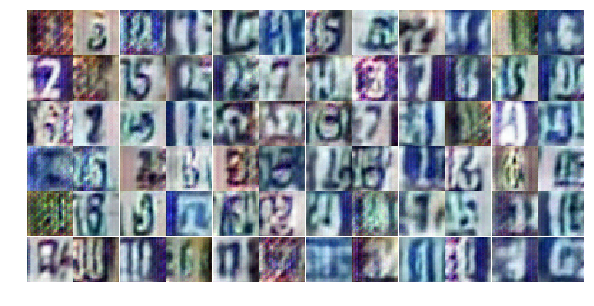

Epoch 7/20... Discriminator Loss: 0.9925... Generator Loss: 0.9374
Epoch 7/20... Discriminator Loss: 0.9983... Generator Loss: 1.2384
Epoch 7/20... Discriminator Loss: 1.1701... Generator Loss: 1.4459
Epoch 7/20... Discriminator Loss: 0.8100... Generator Loss: 1.3233
Epoch 7/20... Discriminator Loss: 0.9583... Generator Loss: 1.2091
Epoch 7/20... Discriminator Loss: 0.7424... Generator Loss: 1.1723
Epoch 7/20... Discriminator Loss: 1.0750... Generator Loss: 1.3248
Epoch 7/20... Discriminator Loss: 1.2181... Generator Loss: 0.5779
Epoch 7/20... Discriminator Loss: 0.9874... Generator Loss: 0.7367
Epoch 7/20... Discriminator Loss: 0.6103... Generator Loss: 1.8394


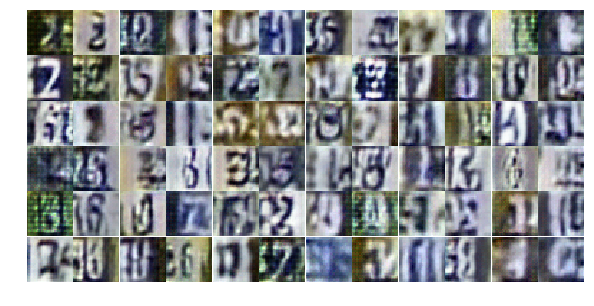

Epoch 7/20... Discriminator Loss: 1.1782... Generator Loss: 2.0884
Epoch 7/20... Discriminator Loss: 1.0686... Generator Loss: 0.8766
Epoch 7/20... Discriminator Loss: 1.0832... Generator Loss: 0.6460
Epoch 7/20... Discriminator Loss: 1.2350... Generator Loss: 0.5946
Epoch 7/20... Discriminator Loss: 0.7692... Generator Loss: 0.9777
Epoch 7/20... Discriminator Loss: 0.9104... Generator Loss: 1.4782
Epoch 7/20... Discriminator Loss: 1.0675... Generator Loss: 0.6244
Epoch 7/20... Discriminator Loss: 1.4468... Generator Loss: 0.3939
Epoch 7/20... Discriminator Loss: 0.9461... Generator Loss: 1.5457
Epoch 7/20... Discriminator Loss: 0.9955... Generator Loss: 1.4170


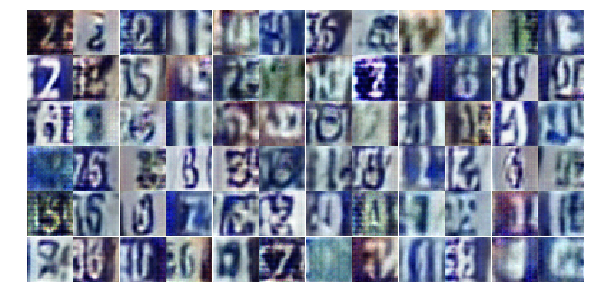

Epoch 7/20... Discriminator Loss: 1.3276... Generator Loss: 0.4278
Epoch 7/20... Discriminator Loss: 1.4544... Generator Loss: 0.3686
Epoch 7/20... Discriminator Loss: 1.1630... Generator Loss: 0.6061
Epoch 7/20... Discriminator Loss: 1.2905... Generator Loss: 0.4875
Epoch 7/20... Discriminator Loss: 0.9273... Generator Loss: 0.8139
Epoch 7/20... Discriminator Loss: 0.8548... Generator Loss: 0.9971
Epoch 7/20... Discriminator Loss: 0.8941... Generator Loss: 0.7957
Epoch 7/20... Discriminator Loss: 0.9597... Generator Loss: 0.7768
Epoch 7/20... Discriminator Loss: 1.4768... Generator Loss: 0.4655
Epoch 7/20... Discriminator Loss: 1.1545... Generator Loss: 0.6734


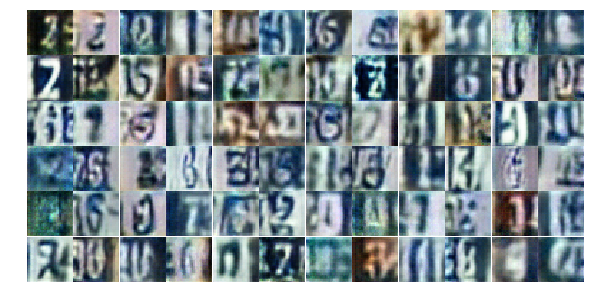

Epoch 7/20... Discriminator Loss: 1.3102... Generator Loss: 0.5275
Epoch 7/20... Discriminator Loss: 1.1408... Generator Loss: 0.6511
Epoch 7/20... Discriminator Loss: 0.9362... Generator Loss: 1.4183
Epoch 7/20... Discriminator Loss: 0.8214... Generator Loss: 1.4965
Epoch 7/20... Discriminator Loss: 1.0765... Generator Loss: 0.7837
Epoch 7/20... Discriminator Loss: 0.6587... Generator Loss: 1.4855
Epoch 7/20... Discriminator Loss: 1.0144... Generator Loss: 0.7077
Epoch 7/20... Discriminator Loss: 1.3016... Generator Loss: 0.7499
Epoch 7/20... Discriminator Loss: 0.7922... Generator Loss: 1.8268
Epoch 7/20... Discriminator Loss: 1.4205... Generator Loss: 0.4790


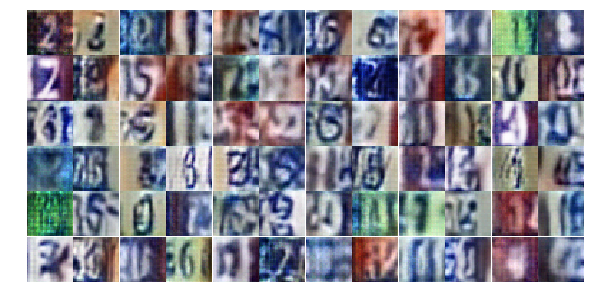

Epoch 7/20... Discriminator Loss: 0.8153... Generator Loss: 1.3199
Epoch 7/20... Discriminator Loss: 0.9670... Generator Loss: 1.2823
Epoch 7/20... Discriminator Loss: 1.1551... Generator Loss: 0.8099
Epoch 7/20... Discriminator Loss: 1.0489... Generator Loss: 0.7944
Epoch 7/20... Discriminator Loss: 0.9196... Generator Loss: 0.9686
Epoch 7/20... Discriminator Loss: 0.7532... Generator Loss: 1.2381
Epoch 7/20... Discriminator Loss: 0.9173... Generator Loss: 1.3444
Epoch 7/20... Discriminator Loss: 0.9857... Generator Loss: 0.7800
Epoch 7/20... Discriminator Loss: 0.9970... Generator Loss: 0.9507
Epoch 7/20... Discriminator Loss: 0.6470... Generator Loss: 1.2365


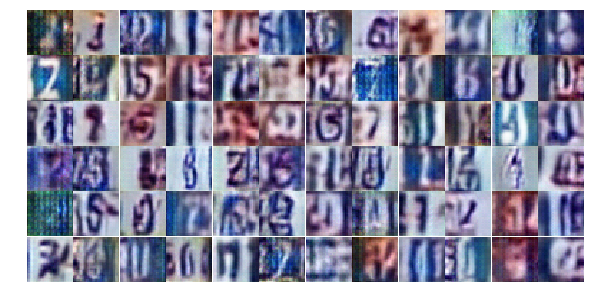

Epoch 7/20... Discriminator Loss: 0.8854... Generator Loss: 1.5058
Epoch 8/20... Discriminator Loss: 0.7920... Generator Loss: 1.0441
Epoch 8/20... Discriminator Loss: 1.3169... Generator Loss: 0.4545
Epoch 8/20... Discriminator Loss: 1.3863... Generator Loss: 0.4118
Epoch 8/20... Discriminator Loss: 1.0558... Generator Loss: 0.9129
Epoch 8/20... Discriminator Loss: 1.1573... Generator Loss: 1.2744
Epoch 8/20... Discriminator Loss: 1.4170... Generator Loss: 0.3763
Epoch 8/20... Discriminator Loss: 0.6697... Generator Loss: 1.4771
Epoch 8/20... Discriminator Loss: 1.0147... Generator Loss: 0.9739
Epoch 8/20... Discriminator Loss: 0.7600... Generator Loss: 1.0933


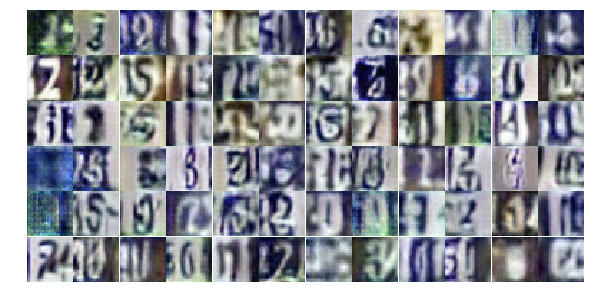

Epoch 8/20... Discriminator Loss: 0.6467... Generator Loss: 1.3723
Epoch 8/20... Discriminator Loss: 0.7059... Generator Loss: 1.6479
Epoch 8/20... Discriminator Loss: 1.0694... Generator Loss: 0.7328
Epoch 8/20... Discriminator Loss: 0.8788... Generator Loss: 1.3088
Epoch 8/20... Discriminator Loss: 1.0806... Generator Loss: 0.6902
Epoch 8/20... Discriminator Loss: 1.0121... Generator Loss: 0.8073
Epoch 8/20... Discriminator Loss: 0.7627... Generator Loss: 1.5390
Epoch 8/20... Discriminator Loss: 1.0273... Generator Loss: 0.7340
Epoch 8/20... Discriminator Loss: 0.9351... Generator Loss: 1.0100
Epoch 8/20... Discriminator Loss: 1.6867... Generator Loss: 0.3453


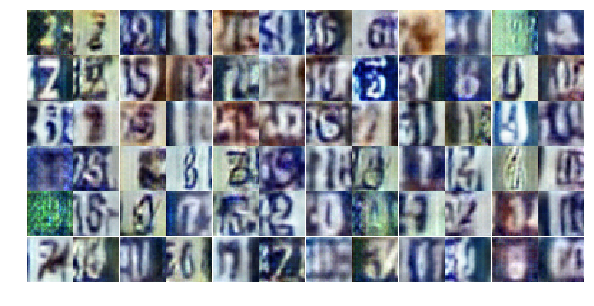

Epoch 8/20... Discriminator Loss: 0.7532... Generator Loss: 1.3682
Epoch 8/20... Discriminator Loss: 0.7700... Generator Loss: 0.9513
Epoch 8/20... Discriminator Loss: 0.8209... Generator Loss: 1.0176
Epoch 8/20... Discriminator Loss: 1.0667... Generator Loss: 0.8354
Epoch 8/20... Discriminator Loss: 0.7961... Generator Loss: 1.4178
Epoch 8/20... Discriminator Loss: 0.6692... Generator Loss: 1.3013
Epoch 8/20... Discriminator Loss: 1.1626... Generator Loss: 2.0281
Epoch 8/20... Discriminator Loss: 1.2878... Generator Loss: 0.5137
Epoch 8/20... Discriminator Loss: 1.1017... Generator Loss: 1.0506
Epoch 8/20... Discriminator Loss: 0.7986... Generator Loss: 0.9568


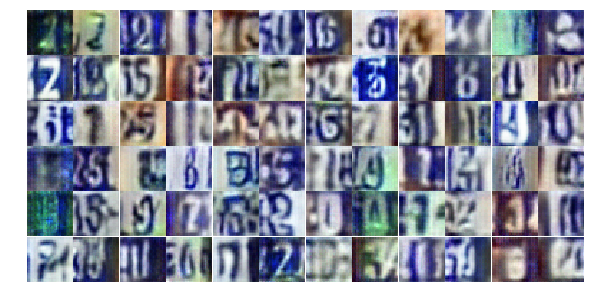

Epoch 8/20... Discriminator Loss: 0.9467... Generator Loss: 1.2338
Epoch 8/20... Discriminator Loss: 1.0012... Generator Loss: 0.7477
Epoch 8/20... Discriminator Loss: 0.8818... Generator Loss: 0.9181
Epoch 8/20... Discriminator Loss: 0.7943... Generator Loss: 0.9797
Epoch 8/20... Discriminator Loss: 1.0089... Generator Loss: 0.6727
Epoch 8/20... Discriminator Loss: 0.7666... Generator Loss: 1.3545
Epoch 8/20... Discriminator Loss: 0.8525... Generator Loss: 1.1396
Epoch 8/20... Discriminator Loss: 0.8859... Generator Loss: 0.9941
Epoch 8/20... Discriminator Loss: 1.0272... Generator Loss: 1.1521
Epoch 8/20... Discriminator Loss: 0.7252... Generator Loss: 1.2146


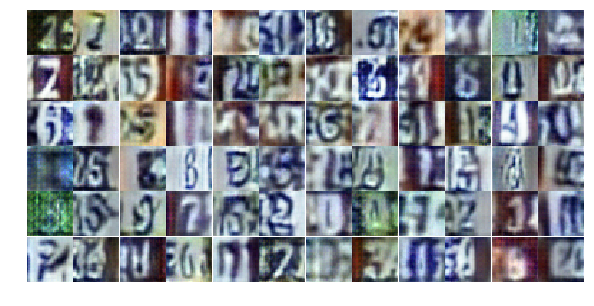

Epoch 8/20... Discriminator Loss: 0.7790... Generator Loss: 1.0875
Epoch 8/20... Discriminator Loss: 1.3311... Generator Loss: 1.0131
Epoch 8/20... Discriminator Loss: 0.7632... Generator Loss: 0.9850
Epoch 8/20... Discriminator Loss: 1.3389... Generator Loss: 0.4472
Epoch 8/20... Discriminator Loss: 1.1666... Generator Loss: 1.5608
Epoch 8/20... Discriminator Loss: 1.0367... Generator Loss: 0.6700
Epoch 8/20... Discriminator Loss: 0.8210... Generator Loss: 1.0212
Epoch 8/20... Discriminator Loss: 0.8838... Generator Loss: 1.3771
Epoch 8/20... Discriminator Loss: 0.7873... Generator Loss: 1.2994
Epoch 8/20... Discriminator Loss: 0.7885... Generator Loss: 1.0968


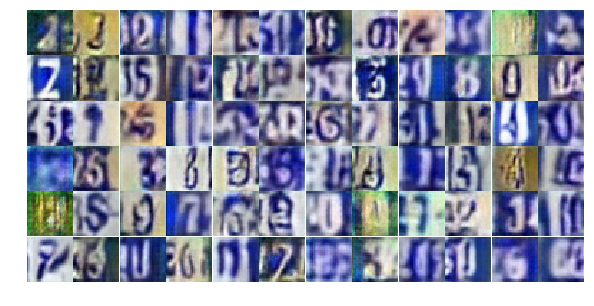

Epoch 8/20... Discriminator Loss: 0.9042... Generator Loss: 1.9370
Epoch 8/20... Discriminator Loss: 0.8256... Generator Loss: 1.0821
Epoch 8/20... Discriminator Loss: 1.0865... Generator Loss: 0.9024
Epoch 8/20... Discriminator Loss: 1.4583... Generator Loss: 0.3884
Epoch 8/20... Discriminator Loss: 0.7811... Generator Loss: 1.9866
Epoch 8/20... Discriminator Loss: 1.4665... Generator Loss: 0.4108
Epoch 8/20... Discriminator Loss: 0.7191... Generator Loss: 1.1990
Epoch 8/20... Discriminator Loss: 0.8908... Generator Loss: 1.4651
Epoch 9/20... Discriminator Loss: 0.9938... Generator Loss: 0.8766
Epoch 9/20... Discriminator Loss: 1.1406... Generator Loss: 0.5711


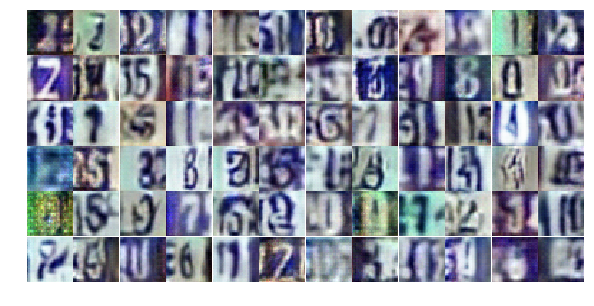

Epoch 9/20... Discriminator Loss: 0.9952... Generator Loss: 0.7825
Epoch 9/20... Discriminator Loss: 1.3274... Generator Loss: 2.0499
Epoch 9/20... Discriminator Loss: 1.3939... Generator Loss: 0.4256
Epoch 9/20... Discriminator Loss: 0.7659... Generator Loss: 1.3505
Epoch 9/20... Discriminator Loss: 1.0954... Generator Loss: 0.6120
Epoch 9/20... Discriminator Loss: 0.9484... Generator Loss: 1.0599
Epoch 9/20... Discriminator Loss: 0.9643... Generator Loss: 1.4192
Epoch 9/20... Discriminator Loss: 0.7291... Generator Loss: 1.2316
Epoch 9/20... Discriminator Loss: 0.8417... Generator Loss: 0.9546
Epoch 9/20... Discriminator Loss: 0.8146... Generator Loss: 1.1163


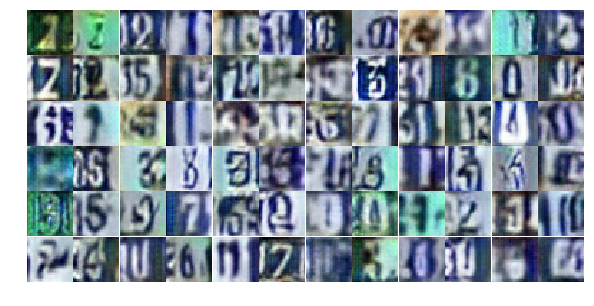

Epoch 9/20... Discriminator Loss: 0.8817... Generator Loss: 0.8512
Epoch 9/20... Discriminator Loss: 1.5288... Generator Loss: 0.5139
Epoch 9/20... Discriminator Loss: 0.8211... Generator Loss: 1.1550
Epoch 9/20... Discriminator Loss: 1.0727... Generator Loss: 0.8036
Epoch 9/20... Discriminator Loss: 0.8127... Generator Loss: 0.9350
Epoch 9/20... Discriminator Loss: 0.8926... Generator Loss: 0.7891
Epoch 9/20... Discriminator Loss: 1.5017... Generator Loss: 0.3435
Epoch 9/20... Discriminator Loss: 1.1996... Generator Loss: 0.5579
Epoch 9/20... Discriminator Loss: 0.9096... Generator Loss: 0.9376
Epoch 9/20... Discriminator Loss: 1.5307... Generator Loss: 0.3546


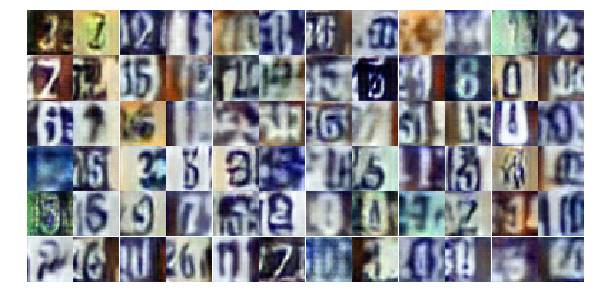

Epoch 9/20... Discriminator Loss: 0.9431... Generator Loss: 0.8272
Epoch 9/20... Discriminator Loss: 1.7692... Generator Loss: 0.2770
Epoch 9/20... Discriminator Loss: 0.9666... Generator Loss: 0.9627
Epoch 9/20... Discriminator Loss: 0.6898... Generator Loss: 1.2137
Epoch 9/20... Discriminator Loss: 0.9010... Generator Loss: 1.2047
Epoch 9/20... Discriminator Loss: 1.1041... Generator Loss: 0.6923
Epoch 9/20... Discriminator Loss: 1.2833... Generator Loss: 0.4734
Epoch 9/20... Discriminator Loss: 0.7404... Generator Loss: 1.7891
Epoch 9/20... Discriminator Loss: 0.7154... Generator Loss: 1.5200
Epoch 9/20... Discriminator Loss: 0.9172... Generator Loss: 0.7170


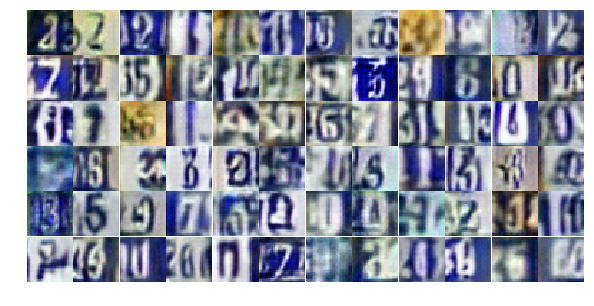

Epoch 9/20... Discriminator Loss: 1.4556... Generator Loss: 0.5710
Epoch 9/20... Discriminator Loss: 1.1397... Generator Loss: 0.6739
Epoch 9/20... Discriminator Loss: 0.8361... Generator Loss: 2.1217
Epoch 9/20... Discriminator Loss: 0.7879... Generator Loss: 0.8828
Epoch 9/20... Discriminator Loss: 0.7257... Generator Loss: 1.1016
Epoch 9/20... Discriminator Loss: 0.6383... Generator Loss: 1.9713
Epoch 9/20... Discriminator Loss: 0.7686... Generator Loss: 3.5536
Epoch 9/20... Discriminator Loss: 0.9361... Generator Loss: 2.7578
Epoch 9/20... Discriminator Loss: 1.3823... Generator Loss: 0.4453
Epoch 9/20... Discriminator Loss: 0.9557... Generator Loss: 0.6633


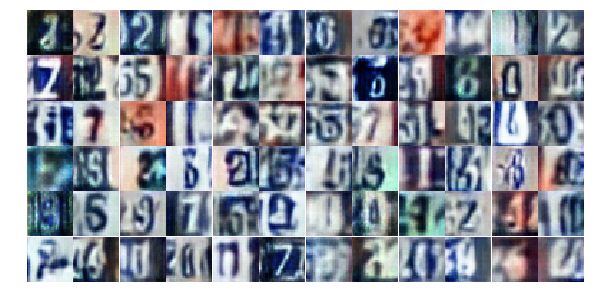

Epoch 9/20... Discriminator Loss: 0.4420... Generator Loss: 1.9028
Epoch 9/20... Discriminator Loss: 1.0747... Generator Loss: 1.9842
Epoch 9/20... Discriminator Loss: 0.6488... Generator Loss: 1.1519
Epoch 9/20... Discriminator Loss: 0.7586... Generator Loss: 0.9200
Epoch 9/20... Discriminator Loss: 0.4245... Generator Loss: 2.3955
Epoch 9/20... Discriminator Loss: 0.9436... Generator Loss: 5.3783
Epoch 9/20... Discriminator Loss: 0.7150... Generator Loss: 1.0209
Epoch 9/20... Discriminator Loss: 0.1700... Generator Loss: 2.5245
Epoch 9/20... Discriminator Loss: 0.2449... Generator Loss: 2.3203
Epoch 9/20... Discriminator Loss: 0.7011... Generator Loss: 2.3369


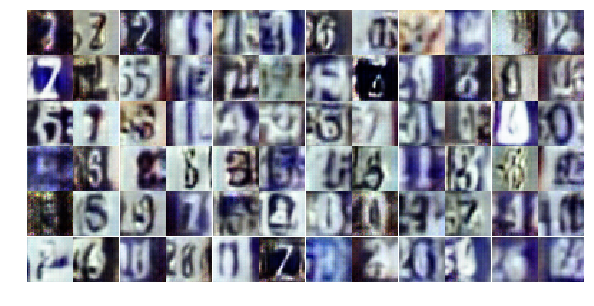

Epoch 9/20... Discriminator Loss: 0.4188... Generator Loss: 3.6934
Epoch 9/20... Discriminator Loss: 0.6766... Generator Loss: 0.9536
Epoch 9/20... Discriminator Loss: 0.2818... Generator Loss: 2.1431
Epoch 9/20... Discriminator Loss: 0.1987... Generator Loss: 2.4439
Epoch 9/20... Discriminator Loss: 1.0335... Generator Loss: 0.7374
Epoch 10/20... Discriminator Loss: 0.6122... Generator Loss: 3.2208
Epoch 10/20... Discriminator Loss: 0.7922... Generator Loss: 1.4093
Epoch 10/20... Discriminator Loss: 0.1761... Generator Loss: 2.5557
Epoch 10/20... Discriminator Loss: 0.1172... Generator Loss: 6.7061
Epoch 10/20... Discriminator Loss: 3.8958... Generator Loss: 0.2580


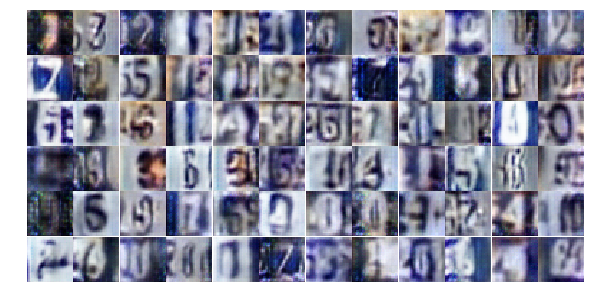

Epoch 10/20... Discriminator Loss: 1.2079... Generator Loss: 0.9638
Epoch 10/20... Discriminator Loss: 1.3600... Generator Loss: 1.0417
Epoch 10/20... Discriminator Loss: 1.4705... Generator Loss: 1.0531
Epoch 10/20... Discriminator Loss: 1.3282... Generator Loss: 0.8816
Epoch 10/20... Discriminator Loss: 1.4004... Generator Loss: 0.8456
Epoch 10/20... Discriminator Loss: 1.2150... Generator Loss: 1.1284
Epoch 10/20... Discriminator Loss: 1.0959... Generator Loss: 1.3039
Epoch 10/20... Discriminator Loss: 1.3324... Generator Loss: 0.9067
Epoch 10/20... Discriminator Loss: 1.0570... Generator Loss: 1.0643
Epoch 10/20... Discriminator Loss: 0.6577... Generator Loss: 1.5219


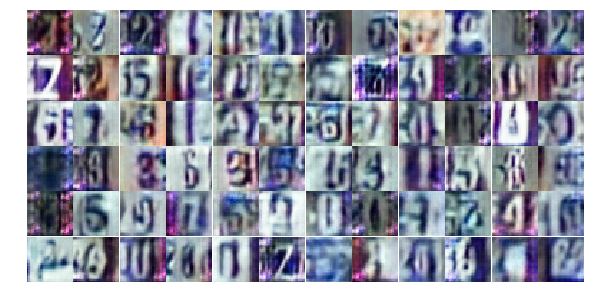

Epoch 10/20... Discriminator Loss: 0.6898... Generator Loss: 1.2816
Epoch 10/20... Discriminator Loss: 0.9324... Generator Loss: 2.8547
Epoch 10/20... Discriminator Loss: 0.8528... Generator Loss: 2.0953
Epoch 10/20... Discriminator Loss: 1.3826... Generator Loss: 1.5199
Epoch 10/20... Discriminator Loss: 0.7904... Generator Loss: 1.0286
Epoch 10/20... Discriminator Loss: 0.7001... Generator Loss: 1.1316
Epoch 10/20... Discriminator Loss: 1.0706... Generator Loss: 0.6713
Epoch 10/20... Discriminator Loss: 0.6533... Generator Loss: 1.4553
Epoch 10/20... Discriminator Loss: 1.3335... Generator Loss: 0.4346
Epoch 10/20... Discriminator Loss: 0.5154... Generator Loss: 2.1701


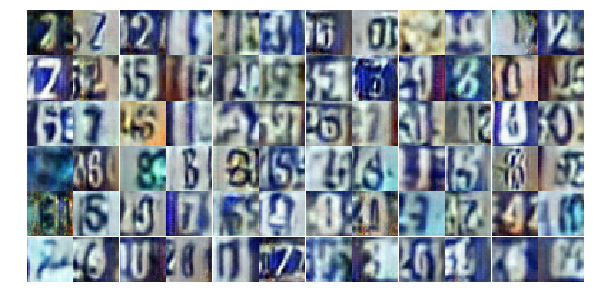

Epoch 10/20... Discriminator Loss: 1.0586... Generator Loss: 0.5903
Epoch 10/20... Discriminator Loss: 0.9379... Generator Loss: 0.8623
Epoch 10/20... Discriminator Loss: 1.4226... Generator Loss: 2.7833
Epoch 10/20... Discriminator Loss: 0.8067... Generator Loss: 1.7181
Epoch 10/20... Discriminator Loss: 1.2001... Generator Loss: 0.5168
Epoch 10/20... Discriminator Loss: 0.9588... Generator Loss: 1.0898
Epoch 10/20... Discriminator Loss: 0.5992... Generator Loss: 1.3334
Epoch 10/20... Discriminator Loss: 0.7357... Generator Loss: 1.1438
Epoch 10/20... Discriminator Loss: 0.4024... Generator Loss: 1.9689
Epoch 10/20... Discriminator Loss: 0.5250... Generator Loss: 1.2196


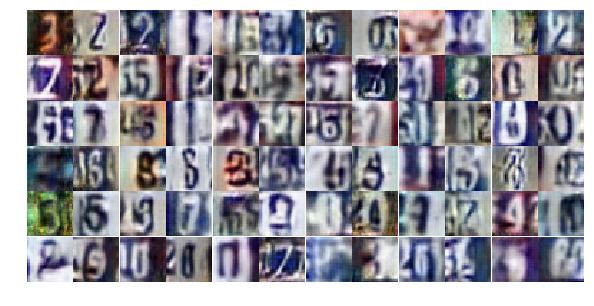

Epoch 10/20... Discriminator Loss: 0.6036... Generator Loss: 1.2562
Epoch 10/20... Discriminator Loss: 0.3625... Generator Loss: 2.2494
Epoch 10/20... Discriminator Loss: 0.3572... Generator Loss: 1.8395
Epoch 10/20... Discriminator Loss: 0.5926... Generator Loss: 3.7945
Epoch 10/20... Discriminator Loss: 0.4610... Generator Loss: 1.5839
Epoch 10/20... Discriminator Loss: 0.4920... Generator Loss: 1.4308
Epoch 10/20... Discriminator Loss: 1.3381... Generator Loss: 0.4471
Epoch 10/20... Discriminator Loss: 1.7552... Generator Loss: 0.4807
Epoch 10/20... Discriminator Loss: 0.8348... Generator Loss: 0.8715
Epoch 10/20... Discriminator Loss: 0.7121... Generator Loss: 2.0162


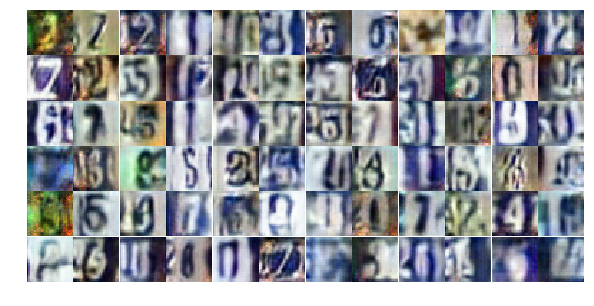

Epoch 10/20... Discriminator Loss: 0.7394... Generator Loss: 1.5098
Epoch 10/20... Discriminator Loss: 0.9323... Generator Loss: 1.0845
Epoch 10/20... Discriminator Loss: 0.8475... Generator Loss: 0.8937
Epoch 10/20... Discriminator Loss: 0.7255... Generator Loss: 1.0761
Epoch 10/20... Discriminator Loss: 0.7158... Generator Loss: 1.5276
Epoch 10/20... Discriminator Loss: 1.2312... Generator Loss: 0.5097
Epoch 10/20... Discriminator Loss: 0.5374... Generator Loss: 1.5948
Epoch 10/20... Discriminator Loss: 0.7550... Generator Loss: 0.9963
Epoch 10/20... Discriminator Loss: 0.7559... Generator Loss: 1.0792
Epoch 10/20... Discriminator Loss: 0.6980... Generator Loss: 1.2062


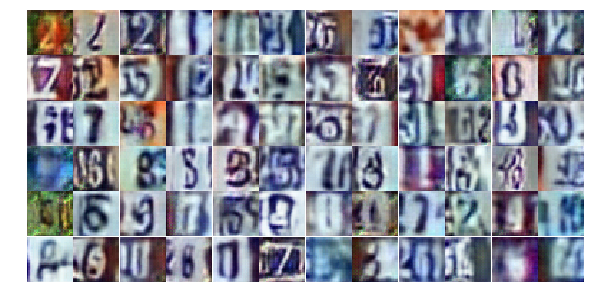

Epoch 10/20... Discriminator Loss: 0.9656... Generator Loss: 1.2197
Epoch 10/20... Discriminator Loss: 0.7483... Generator Loss: 1.0105
Epoch 10/20... Discriminator Loss: 0.4987... Generator Loss: 1.5412
Epoch 11/20... Discriminator Loss: 0.8082... Generator Loss: 1.1217
Epoch 11/20... Discriminator Loss: 0.8203... Generator Loss: 1.1837
Epoch 11/20... Discriminator Loss: 1.3853... Generator Loss: 0.4443
Epoch 11/20... Discriminator Loss: 1.3689... Generator Loss: 0.4719
Epoch 11/20... Discriminator Loss: 0.8695... Generator Loss: 0.8893
Epoch 11/20... Discriminator Loss: 1.7045... Generator Loss: 0.2965
Epoch 11/20... Discriminator Loss: 0.7857... Generator Loss: 0.9633


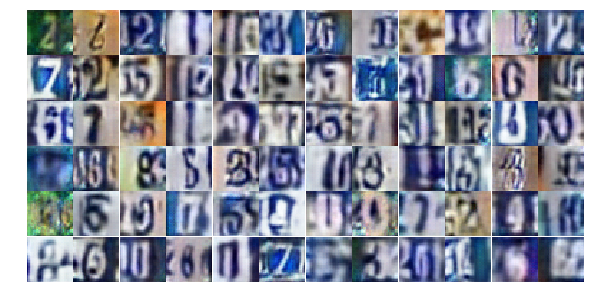

Epoch 11/20... Discriminator Loss: 0.8140... Generator Loss: 1.1708
Epoch 11/20... Discriminator Loss: 0.6950... Generator Loss: 1.4425
Epoch 11/20... Discriminator Loss: 0.9347... Generator Loss: 0.6690
Epoch 11/20... Discriminator Loss: 0.9405... Generator Loss: 0.8554
Epoch 11/20... Discriminator Loss: 0.8735... Generator Loss: 0.9861
Epoch 11/20... Discriminator Loss: 0.3939... Generator Loss: 2.1831
Epoch 11/20... Discriminator Loss: 0.9023... Generator Loss: 0.9449
Epoch 11/20... Discriminator Loss: 0.4820... Generator Loss: 1.9897
Epoch 11/20... Discriminator Loss: 1.6570... Generator Loss: 0.3245
Epoch 11/20... Discriminator Loss: 1.3628... Generator Loss: 0.4457


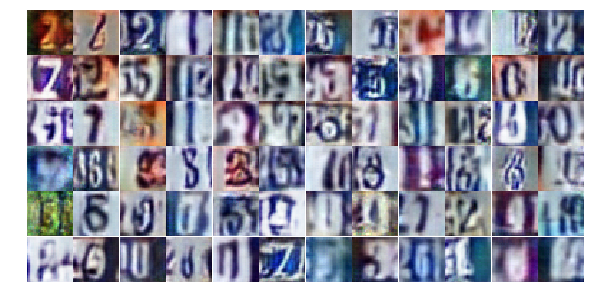

Epoch 11/20... Discriminator Loss: 1.0722... Generator Loss: 1.0060
Epoch 11/20... Discriminator Loss: 0.8450... Generator Loss: 1.6268
Epoch 11/20... Discriminator Loss: 1.1667... Generator Loss: 0.5758
Epoch 11/20... Discriminator Loss: 0.8341... Generator Loss: 0.9258
Epoch 11/20... Discriminator Loss: 0.5862... Generator Loss: 1.6207
Epoch 11/20... Discriminator Loss: 0.7969... Generator Loss: 1.2844
Epoch 11/20... Discriminator Loss: 0.8036... Generator Loss: 1.2414
Epoch 11/20... Discriminator Loss: 0.8576... Generator Loss: 1.0171
Epoch 11/20... Discriminator Loss: 0.6731... Generator Loss: 1.4150
Epoch 11/20... Discriminator Loss: 0.9928... Generator Loss: 0.7225


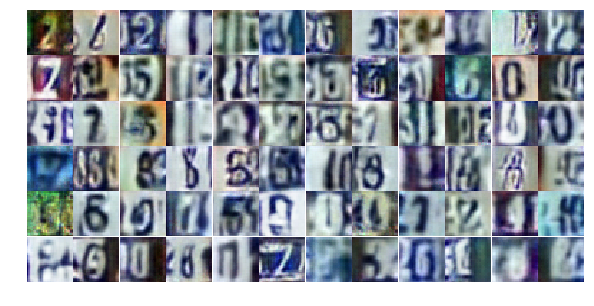

Epoch 11/20... Discriminator Loss: 1.0798... Generator Loss: 0.6769
Epoch 11/20... Discriminator Loss: 0.9825... Generator Loss: 0.9428
Epoch 11/20... Discriminator Loss: 0.8849... Generator Loss: 0.9715
Epoch 11/20... Discriminator Loss: 0.7508... Generator Loss: 1.5638
Epoch 11/20... Discriminator Loss: 1.3522... Generator Loss: 0.4198
Epoch 11/20... Discriminator Loss: 1.0032... Generator Loss: 0.9084
Epoch 11/20... Discriminator Loss: 1.2879... Generator Loss: 0.4904
Epoch 11/20... Discriminator Loss: 0.9835... Generator Loss: 1.5511
Epoch 11/20... Discriminator Loss: 1.0320... Generator Loss: 0.7139
Epoch 11/20... Discriminator Loss: 1.1770... Generator Loss: 0.5461


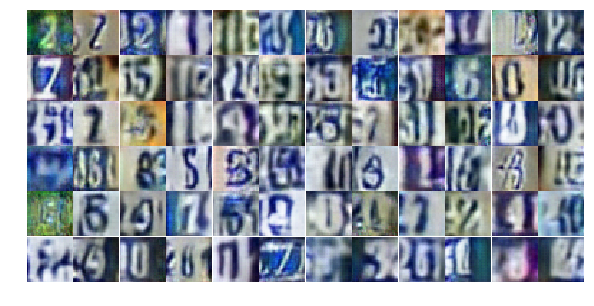

Epoch 11/20... Discriminator Loss: 0.8386... Generator Loss: 0.9598
Epoch 11/20... Discriminator Loss: 0.8253... Generator Loss: 0.9741
Epoch 11/20... Discriminator Loss: 0.8693... Generator Loss: 1.0006
Epoch 11/20... Discriminator Loss: 0.9372... Generator Loss: 0.9318
Epoch 11/20... Discriminator Loss: 0.8585... Generator Loss: 1.3814
Epoch 11/20... Discriminator Loss: 0.9857... Generator Loss: 1.0907
Epoch 11/20... Discriminator Loss: 0.3788... Generator Loss: 2.4127
Epoch 11/20... Discriminator Loss: 0.6865... Generator Loss: 1.2290
Epoch 11/20... Discriminator Loss: 1.4367... Generator Loss: 0.4294
Epoch 11/20... Discriminator Loss: 0.7428... Generator Loss: 0.9902


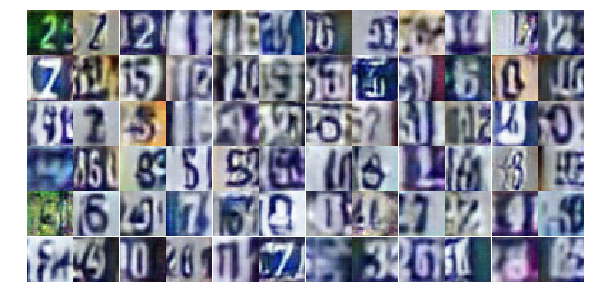

Epoch 11/20... Discriminator Loss: 0.5768... Generator Loss: 1.7494
Epoch 11/20... Discriminator Loss: 0.7617... Generator Loss: 1.3184
Epoch 11/20... Discriminator Loss: 0.8816... Generator Loss: 1.3352
Epoch 11/20... Discriminator Loss: 0.5788... Generator Loss: 1.2984
Epoch 11/20... Discriminator Loss: 1.5454... Generator Loss: 0.3313
Epoch 11/20... Discriminator Loss: 0.8995... Generator Loss: 0.9987
Epoch 11/20... Discriminator Loss: 1.0398... Generator Loss: 0.8035
Epoch 11/20... Discriminator Loss: 0.8045... Generator Loss: 1.0596
Epoch 11/20... Discriminator Loss: 0.9760... Generator Loss: 0.8002
Epoch 11/20... Discriminator Loss: 0.9463... Generator Loss: 0.7413


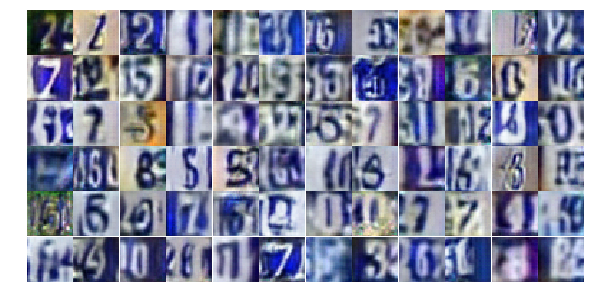

Epoch 12/20... Discriminator Loss: 1.0389... Generator Loss: 0.9691
Epoch 12/20... Discriminator Loss: 0.8818... Generator Loss: 1.0385
Epoch 12/20... Discriminator Loss: 1.0033... Generator Loss: 0.9114
Epoch 12/20... Discriminator Loss: 0.7602... Generator Loss: 1.2480
Epoch 12/20... Discriminator Loss: 0.4220... Generator Loss: 1.8068
Epoch 12/20... Discriminator Loss: 0.9693... Generator Loss: 1.0525
Epoch 12/20... Discriminator Loss: 0.8114... Generator Loss: 1.0045
Epoch 12/20... Discriminator Loss: 0.7814... Generator Loss: 1.0980
Epoch 12/20... Discriminator Loss: 0.4469... Generator Loss: 1.6830
Epoch 12/20... Discriminator Loss: 0.8572... Generator Loss: 1.0012


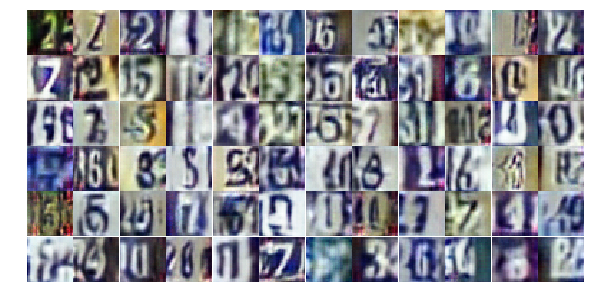

Epoch 12/20... Discriminator Loss: 0.4435... Generator Loss: 1.4149
Epoch 12/20... Discriminator Loss: 0.5677... Generator Loss: 1.1644
Epoch 12/20... Discriminator Loss: 0.5178... Generator Loss: 1.2542
Epoch 12/20... Discriminator Loss: 0.6531... Generator Loss: 1.1737
Epoch 12/20... Discriminator Loss: 0.1511... Generator Loss: 3.1802
Epoch 12/20... Discriminator Loss: 0.4854... Generator Loss: 1.2899
Epoch 12/20... Discriminator Loss: 0.5922... Generator Loss: 1.0520
Epoch 12/20... Discriminator Loss: 0.4768... Generator Loss: 1.2988
Epoch 12/20... Discriminator Loss: 0.4019... Generator Loss: 1.4661
Epoch 12/20... Discriminator Loss: 0.3414... Generator Loss: 1.6704


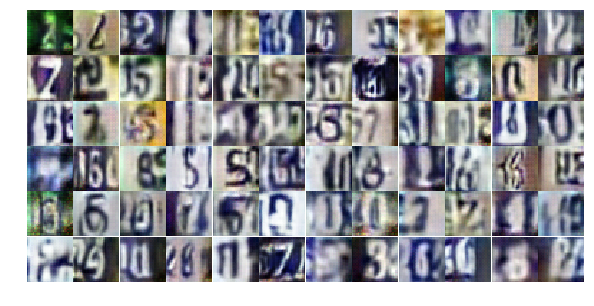

Epoch 12/20... Discriminator Loss: 0.2712... Generator Loss: 4.1935
Epoch 12/20... Discriminator Loss: 0.2716... Generator Loss: 3.5841
Epoch 12/20... Discriminator Loss: 0.9537... Generator Loss: 2.1172
Epoch 12/20... Discriminator Loss: 1.2045... Generator Loss: 1.0493
Epoch 12/20... Discriminator Loss: 0.9826... Generator Loss: 1.0365
Epoch 12/20... Discriminator Loss: 0.7493... Generator Loss: 1.8294
Epoch 12/20... Discriminator Loss: 1.0132... Generator Loss: 0.8948
Epoch 12/20... Discriminator Loss: 0.8264... Generator Loss: 1.0595
Epoch 12/20... Discriminator Loss: 0.7653... Generator Loss: 1.1738
Epoch 12/20... Discriminator Loss: 0.7825... Generator Loss: 1.4687


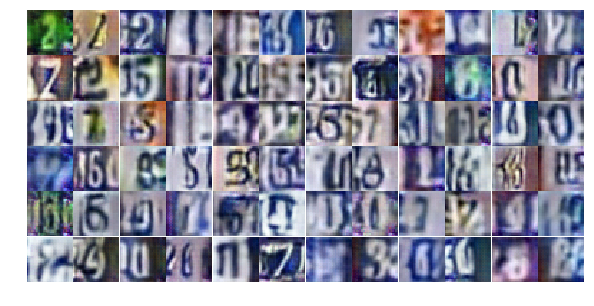

Epoch 12/20... Discriminator Loss: 0.7565... Generator Loss: 1.2481
Epoch 12/20... Discriminator Loss: 0.9369... Generator Loss: 0.7790
Epoch 12/20... Discriminator Loss: 0.9322... Generator Loss: 1.0424
Epoch 12/20... Discriminator Loss: 1.6125... Generator Loss: 0.3134
Epoch 12/20... Discriminator Loss: 0.9950... Generator Loss: 1.3119
Epoch 12/20... Discriminator Loss: 0.8324... Generator Loss: 1.0268
Epoch 12/20... Discriminator Loss: 0.9914... Generator Loss: 0.7854
Epoch 12/20... Discriminator Loss: 0.8398... Generator Loss: 1.3085
Epoch 12/20... Discriminator Loss: 0.7902... Generator Loss: 1.0845
Epoch 12/20... Discriminator Loss: 0.6558... Generator Loss: 1.6626


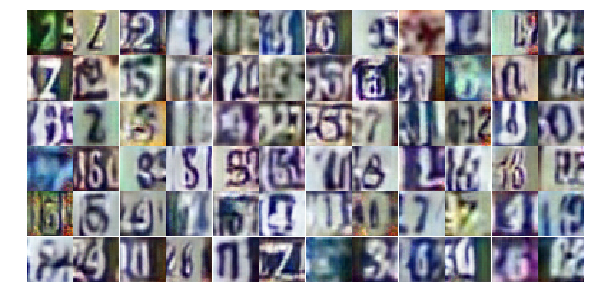

Epoch 12/20... Discriminator Loss: 0.8800... Generator Loss: 0.7784
Epoch 12/20... Discriminator Loss: 0.6049... Generator Loss: 1.6444
Epoch 12/20... Discriminator Loss: 0.5404... Generator Loss: 1.3513
Epoch 12/20... Discriminator Loss: 1.0274... Generator Loss: 0.7707
Epoch 12/20... Discriminator Loss: 0.8531... Generator Loss: 1.0352
Epoch 12/20... Discriminator Loss: 1.5336... Generator Loss: 0.3544
Epoch 12/20... Discriminator Loss: 0.7261... Generator Loss: 1.2538
Epoch 12/20... Discriminator Loss: 1.2149... Generator Loss: 0.4950
Epoch 12/20... Discriminator Loss: 0.7570... Generator Loss: 1.0996
Epoch 12/20... Discriminator Loss: 0.8516... Generator Loss: 0.8313


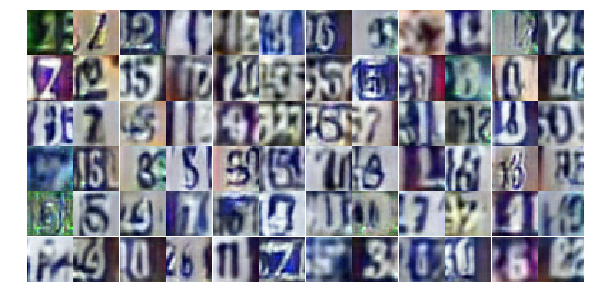

Epoch 12/20... Discriminator Loss: 0.9318... Generator Loss: 0.8256
Epoch 12/20... Discriminator Loss: 1.3260... Generator Loss: 0.5014
Epoch 12/20... Discriminator Loss: 0.9439... Generator Loss: 1.3046
Epoch 12/20... Discriminator Loss: 1.2537... Generator Loss: 0.5279
Epoch 12/20... Discriminator Loss: 0.7359... Generator Loss: 1.1462
Epoch 12/20... Discriminator Loss: 1.0458... Generator Loss: 1.7324
Epoch 12/20... Discriminator Loss: 0.7840... Generator Loss: 1.1060
Epoch 13/20... Discriminator Loss: 0.7502... Generator Loss: 1.1403
Epoch 13/20... Discriminator Loss: 0.7135... Generator Loss: 1.1170
Epoch 13/20... Discriminator Loss: 0.9405... Generator Loss: 0.7808


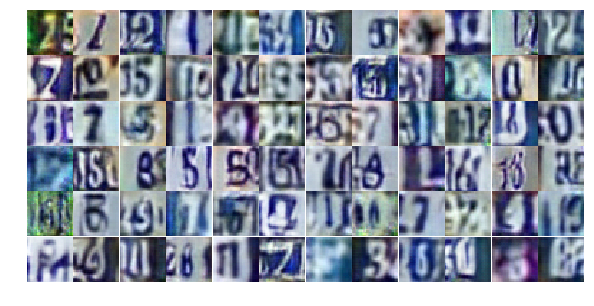

Epoch 13/20... Discriminator Loss: 0.8250... Generator Loss: 1.8304
Epoch 13/20... Discriminator Loss: 1.0276... Generator Loss: 1.1844
Epoch 13/20... Discriminator Loss: 1.2389... Generator Loss: 0.5996
Epoch 13/20... Discriminator Loss: 1.2584... Generator Loss: 0.4833
Epoch 13/20... Discriminator Loss: 0.8675... Generator Loss: 0.8865
Epoch 13/20... Discriminator Loss: 0.5694... Generator Loss: 1.3866
Epoch 13/20... Discriminator Loss: 0.5558... Generator Loss: 1.6507
Epoch 13/20... Discriminator Loss: 0.8114... Generator Loss: 0.9610
Epoch 13/20... Discriminator Loss: 0.6906... Generator Loss: 1.2459
Epoch 13/20... Discriminator Loss: 0.6784... Generator Loss: 1.2967


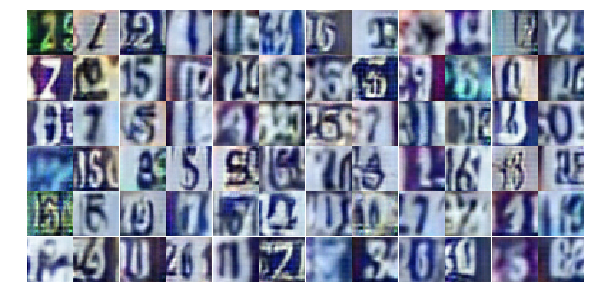

Epoch 13/20... Discriminator Loss: 0.9630... Generator Loss: 0.7891
Epoch 13/20... Discriminator Loss: 0.5756... Generator Loss: 1.3305
Epoch 13/20... Discriminator Loss: 1.2495... Generator Loss: 0.5172
Epoch 13/20... Discriminator Loss: 0.8750... Generator Loss: 1.1231
Epoch 13/20... Discriminator Loss: 0.8302... Generator Loss: 1.1763
Epoch 13/20... Discriminator Loss: 0.9459... Generator Loss: 0.8173
Epoch 13/20... Discriminator Loss: 0.8644... Generator Loss: 1.0335
Epoch 13/20... Discriminator Loss: 1.0555... Generator Loss: 0.8250
Epoch 13/20... Discriminator Loss: 0.7600... Generator Loss: 1.1892
Epoch 13/20... Discriminator Loss: 1.0497... Generator Loss: 0.7147


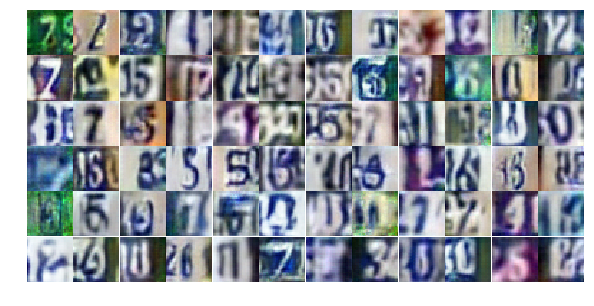

Epoch 13/20... Discriminator Loss: 0.7465... Generator Loss: 1.0629
Epoch 13/20... Discriminator Loss: 0.8291... Generator Loss: 0.9915
Epoch 13/20... Discriminator Loss: 0.8332... Generator Loss: 0.9848
Epoch 13/20... Discriminator Loss: 0.8622... Generator Loss: 1.2534
Epoch 13/20... Discriminator Loss: 0.7653... Generator Loss: 1.1408
Epoch 13/20... Discriminator Loss: 1.7732... Generator Loss: 0.3080
Epoch 13/20... Discriminator Loss: 1.0596... Generator Loss: 1.4638
Epoch 13/20... Discriminator Loss: 0.7395... Generator Loss: 1.1323
Epoch 13/20... Discriminator Loss: 0.7952... Generator Loss: 1.0234
Epoch 13/20... Discriminator Loss: 0.7442... Generator Loss: 1.3692


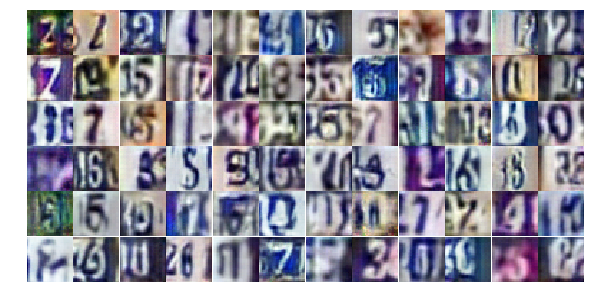

Epoch 13/20... Discriminator Loss: 0.8005... Generator Loss: 0.8794
Epoch 13/20... Discriminator Loss: 0.9948... Generator Loss: 1.1309
Epoch 13/20... Discriminator Loss: 0.9744... Generator Loss: 0.7158
Epoch 13/20... Discriminator Loss: 1.1491... Generator Loss: 0.6635
Epoch 13/20... Discriminator Loss: 0.6656... Generator Loss: 1.3263
Epoch 13/20... Discriminator Loss: 0.7644... Generator Loss: 0.9850
Epoch 13/20... Discriminator Loss: 0.6758... Generator Loss: 1.1164
Epoch 13/20... Discriminator Loss: 1.1853... Generator Loss: 0.5476
Epoch 13/20... Discriminator Loss: 0.7639... Generator Loss: 1.2490
Epoch 13/20... Discriminator Loss: 0.8463... Generator Loss: 1.3099


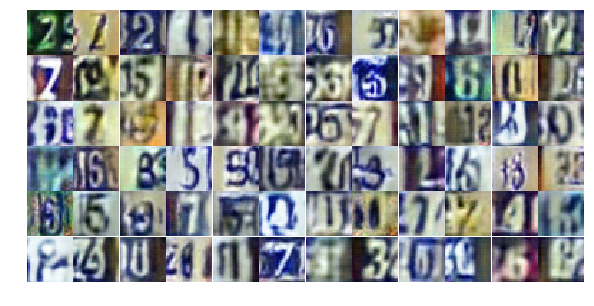

Epoch 13/20... Discriminator Loss: 0.7107... Generator Loss: 1.5255
Epoch 13/20... Discriminator Loss: 0.9186... Generator Loss: 1.5933
Epoch 13/20... Discriminator Loss: 1.3555... Generator Loss: 0.4502
Epoch 13/20... Discriminator Loss: 0.5543... Generator Loss: 1.2761
Epoch 13/20... Discriminator Loss: 1.1871... Generator Loss: 1.4274
Epoch 13/20... Discriminator Loss: 1.0824... Generator Loss: 0.7812
Epoch 13/20... Discriminator Loss: 1.0050... Generator Loss: 0.6948
Epoch 13/20... Discriminator Loss: 0.7553... Generator Loss: 0.9348
Epoch 13/20... Discriminator Loss: 0.8555... Generator Loss: 0.8043
Epoch 13/20... Discriminator Loss: 1.3147... Generator Loss: 0.4569


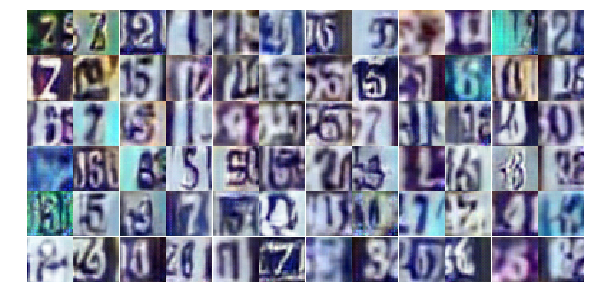

Epoch 13/20... Discriminator Loss: 0.4161... Generator Loss: 1.6085
Epoch 13/20... Discriminator Loss: 0.8409... Generator Loss: 1.0166
Epoch 13/20... Discriminator Loss: 0.3938... Generator Loss: 2.0195
Epoch 13/20... Discriminator Loss: 0.4130... Generator Loss: 1.8618
Epoch 14/20... Discriminator Loss: 1.3629... Generator Loss: 0.4236
Epoch 14/20... Discriminator Loss: 0.2567... Generator Loss: 2.5083
Epoch 14/20... Discriminator Loss: 0.5638... Generator Loss: 2.7299
Epoch 14/20... Discriminator Loss: 0.4377... Generator Loss: 3.0905
Epoch 14/20... Discriminator Loss: 0.0958... Generator Loss: 4.6738
Epoch 14/20... Discriminator Loss: 0.2374... Generator Loss: 2.5939


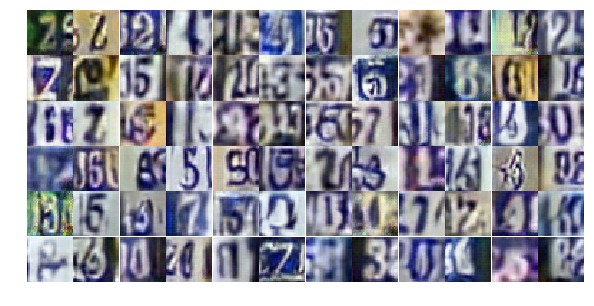

Epoch 14/20... Discriminator Loss: 0.1963... Generator Loss: 3.2533
Epoch 14/20... Discriminator Loss: 0.7003... Generator Loss: 0.9074
Epoch 14/20... Discriminator Loss: 0.0980... Generator Loss: 3.6742
Epoch 14/20... Discriminator Loss: 0.3009... Generator Loss: 2.0369
Epoch 14/20... Discriminator Loss: 0.8306... Generator Loss: 0.7868
Epoch 14/20... Discriminator Loss: 0.3127... Generator Loss: 1.7646
Epoch 14/20... Discriminator Loss: 0.0972... Generator Loss: 3.7803
Epoch 14/20... Discriminator Loss: 0.8701... Generator Loss: 0.7903
Epoch 14/20... Discriminator Loss: 2.3778... Generator Loss: 1.5940
Epoch 14/20... Discriminator Loss: 1.6453... Generator Loss: 0.8329


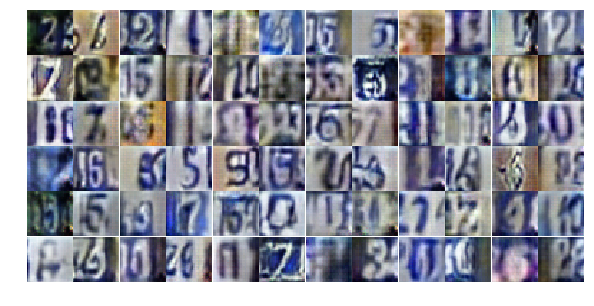

Epoch 14/20... Discriminator Loss: 1.2931... Generator Loss: 1.0797
Epoch 14/20... Discriminator Loss: 1.2188... Generator Loss: 1.3103
Epoch 14/20... Discriminator Loss: 1.1265... Generator Loss: 0.9545
Epoch 14/20... Discriminator Loss: 0.8459... Generator Loss: 1.1173
Epoch 14/20... Discriminator Loss: 3.0950... Generator Loss: 4.3512
Epoch 14/20... Discriminator Loss: 1.0314... Generator Loss: 0.7903
Epoch 14/20... Discriminator Loss: 1.4346... Generator Loss: 0.4486
Epoch 14/20... Discriminator Loss: 1.0087... Generator Loss: 0.8040
Epoch 14/20... Discriminator Loss: 0.7392... Generator Loss: 1.6929
Epoch 14/20... Discriminator Loss: 0.9289... Generator Loss: 2.5573


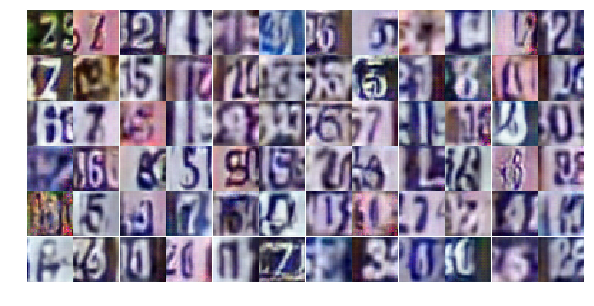

Epoch 14/20... Discriminator Loss: 1.1395... Generator Loss: 0.6259
Epoch 14/20... Discriminator Loss: 0.5468... Generator Loss: 1.5021
Epoch 14/20... Discriminator Loss: 0.7639... Generator Loss: 1.1525
Epoch 14/20... Discriminator Loss: 0.7513... Generator Loss: 1.1265
Epoch 14/20... Discriminator Loss: 0.7288... Generator Loss: 1.5994
Epoch 14/20... Discriminator Loss: 0.7576... Generator Loss: 1.1582
Epoch 14/20... Discriminator Loss: 0.8367... Generator Loss: 1.1530
Epoch 14/20... Discriminator Loss: 0.4977... Generator Loss: 1.7560
Epoch 14/20... Discriminator Loss: 0.6397... Generator Loss: 1.2381
Epoch 14/20... Discriminator Loss: 1.1386... Generator Loss: 0.6176


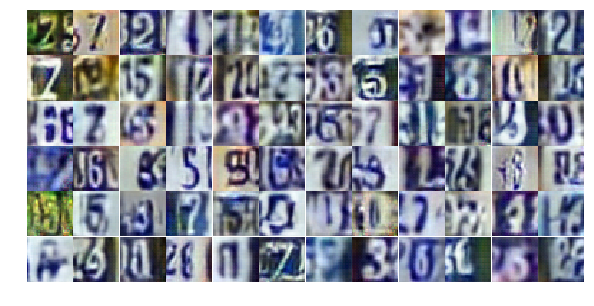

Epoch 14/20... Discriminator Loss: 1.2440... Generator Loss: 0.5055
Epoch 14/20... Discriminator Loss: 0.8826... Generator Loss: 0.9853
Epoch 14/20... Discriminator Loss: 0.8430... Generator Loss: 0.8451
Epoch 14/20... Discriminator Loss: 1.1752... Generator Loss: 0.5441
Epoch 14/20... Discriminator Loss: 1.1533... Generator Loss: 0.6255
Epoch 14/20... Discriminator Loss: 1.0080... Generator Loss: 0.8830
Epoch 14/20... Discriminator Loss: 0.8609... Generator Loss: 0.8301
Epoch 14/20... Discriminator Loss: 0.6945... Generator Loss: 1.1548
Epoch 14/20... Discriminator Loss: 0.9026... Generator Loss: 0.8073
Epoch 14/20... Discriminator Loss: 1.0136... Generator Loss: 1.1621


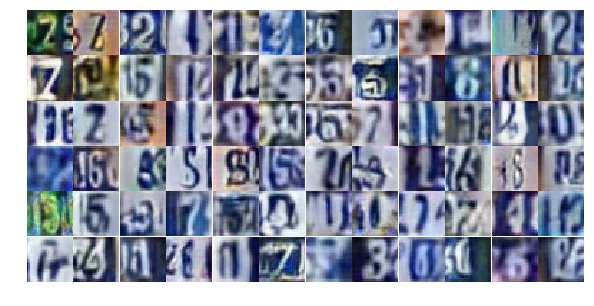

Epoch 14/20... Discriminator Loss: 1.0675... Generator Loss: 0.9363
Epoch 14/20... Discriminator Loss: 1.1032... Generator Loss: 0.6237
Epoch 14/20... Discriminator Loss: 0.9084... Generator Loss: 1.4677
Epoch 14/20... Discriminator Loss: 1.1056... Generator Loss: 0.6063
Epoch 14/20... Discriminator Loss: 1.1473... Generator Loss: 0.5473
Epoch 14/20... Discriminator Loss: 0.8201... Generator Loss: 0.8449
Epoch 14/20... Discriminator Loss: 0.8515... Generator Loss: 0.8796
Epoch 14/20... Discriminator Loss: 0.7205... Generator Loss: 1.1871
Epoch 14/20... Discriminator Loss: 1.1622... Generator Loss: 0.5248
Epoch 14/20... Discriminator Loss: 0.7507... Generator Loss: 0.9296


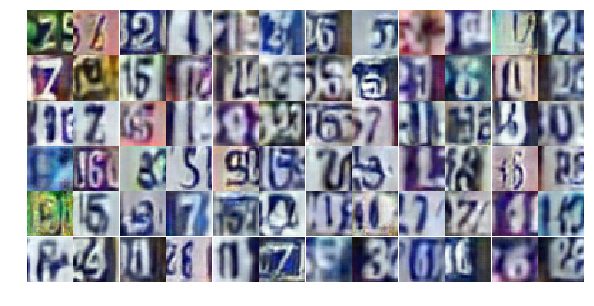

Epoch 14/20... Discriminator Loss: 1.0391... Generator Loss: 1.1137
Epoch 14/20... Discriminator Loss: 1.1396... Generator Loss: 0.5815
Epoch 15/20... Discriminator Loss: 1.0120... Generator Loss: 0.7523
Epoch 15/20... Discriminator Loss: 0.6874... Generator Loss: 1.5155
Epoch 15/20... Discriminator Loss: 0.7021... Generator Loss: 1.1715
Epoch 15/20... Discriminator Loss: 1.0047... Generator Loss: 0.6616
Epoch 15/20... Discriminator Loss: 0.8457... Generator Loss: 0.9889
Epoch 15/20... Discriminator Loss: 0.8099... Generator Loss: 1.2765
Epoch 15/20... Discriminator Loss: 1.0707... Generator Loss: 0.6577
Epoch 15/20... Discriminator Loss: 0.7263... Generator Loss: 1.0812


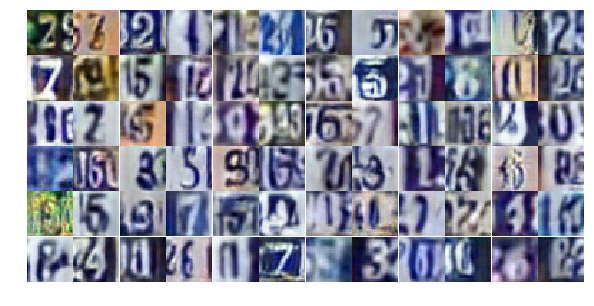

Epoch 15/20... Discriminator Loss: 1.0308... Generator Loss: 0.6561
Epoch 15/20... Discriminator Loss: 0.8395... Generator Loss: 1.2604
Epoch 15/20... Discriminator Loss: 0.9267... Generator Loss: 0.7696
Epoch 15/20... Discriminator Loss: 0.9729... Generator Loss: 0.7491
Epoch 15/20... Discriminator Loss: 1.0828... Generator Loss: 0.7262
Epoch 15/20... Discriminator Loss: 0.6191... Generator Loss: 1.6963
Epoch 15/20... Discriminator Loss: 1.4274... Generator Loss: 0.4021
Epoch 15/20... Discriminator Loss: 1.2952... Generator Loss: 0.5045
Epoch 15/20... Discriminator Loss: 0.9203... Generator Loss: 1.9067
Epoch 15/20... Discriminator Loss: 1.4153... Generator Loss: 0.4306


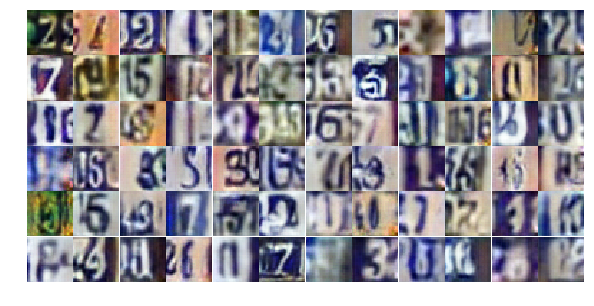

Epoch 15/20... Discriminator Loss: 0.9509... Generator Loss: 0.8196
Epoch 15/20... Discriminator Loss: 0.8810... Generator Loss: 1.0500
Epoch 15/20... Discriminator Loss: 0.7534... Generator Loss: 1.1911
Epoch 15/20... Discriminator Loss: 0.7741... Generator Loss: 1.0425
Epoch 15/20... Discriminator Loss: 1.0651... Generator Loss: 0.6537
Epoch 15/20... Discriminator Loss: 0.7408... Generator Loss: 1.1314
Epoch 15/20... Discriminator Loss: 1.1431... Generator Loss: 0.5595
Epoch 15/20... Discriminator Loss: 1.0400... Generator Loss: 0.6386
Epoch 15/20... Discriminator Loss: 0.8709... Generator Loss: 0.7857
Epoch 15/20... Discriminator Loss: 1.5339... Generator Loss: 0.3455


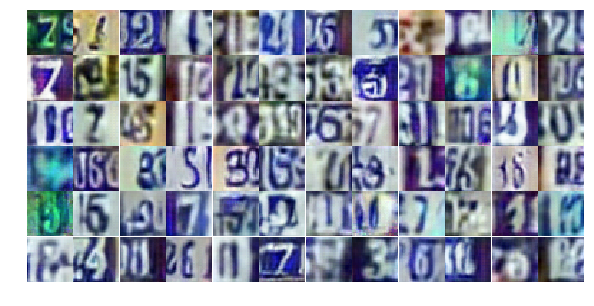

Epoch 15/20... Discriminator Loss: 0.7715... Generator Loss: 1.0139
Epoch 15/20... Discriminator Loss: 0.7323... Generator Loss: 1.1410
Epoch 15/20... Discriminator Loss: 0.5281... Generator Loss: 1.3399
Epoch 15/20... Discriminator Loss: 0.9040... Generator Loss: 0.7696
Epoch 15/20... Discriminator Loss: 0.8464... Generator Loss: 0.9349
Epoch 15/20... Discriminator Loss: 0.9460... Generator Loss: 1.7917
Epoch 15/20... Discriminator Loss: 0.6837... Generator Loss: 1.3906
Epoch 15/20... Discriminator Loss: 0.8504... Generator Loss: 1.0495
Epoch 15/20... Discriminator Loss: 0.5772... Generator Loss: 1.2726
Epoch 15/20... Discriminator Loss: 0.7745... Generator Loss: 1.3048


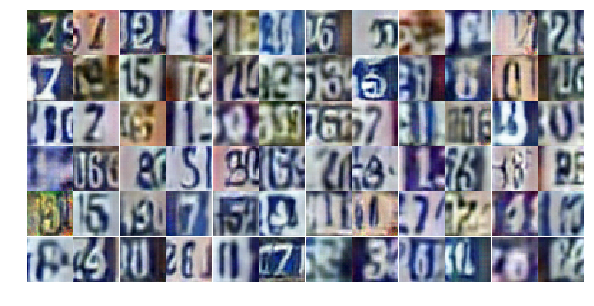

Epoch 15/20... Discriminator Loss: 0.6296... Generator Loss: 1.2152
Epoch 15/20... Discriminator Loss: 1.5101... Generator Loss: 0.3251
Epoch 15/20... Discriminator Loss: 0.4918... Generator Loss: 1.7222
Epoch 15/20... Discriminator Loss: 0.2781... Generator Loss: 2.6500
Epoch 15/20... Discriminator Loss: 0.2513... Generator Loss: 2.1565
Epoch 15/20... Discriminator Loss: 1.9431... Generator Loss: 0.2639
Epoch 15/20... Discriminator Loss: 1.8369... Generator Loss: 0.9295
Epoch 15/20... Discriminator Loss: 1.9696... Generator Loss: 0.5259
Epoch 15/20... Discriminator Loss: 1.2900... Generator Loss: 1.1631
Epoch 15/20... Discriminator Loss: 1.2305... Generator Loss: 1.7244


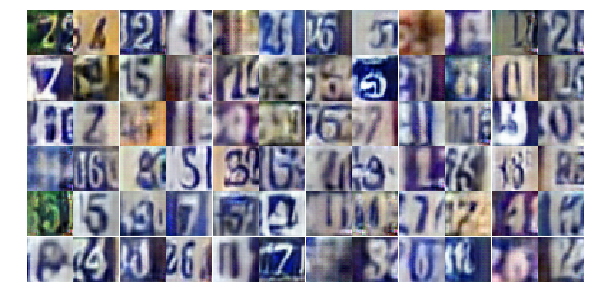

Epoch 15/20... Discriminator Loss: 1.7948... Generator Loss: 0.3517
Epoch 15/20... Discriminator Loss: 1.4031... Generator Loss: 0.5835
Epoch 15/20... Discriminator Loss: 0.8412... Generator Loss: 1.6948
Epoch 15/20... Discriminator Loss: 1.2011... Generator Loss: 0.8773
Epoch 15/20... Discriminator Loss: 0.8835... Generator Loss: 1.1901
Epoch 15/20... Discriminator Loss: 1.0950... Generator Loss: 0.6286
Epoch 15/20... Discriminator Loss: 1.0623... Generator Loss: 0.6439
Epoch 15/20... Discriminator Loss: 0.7305... Generator Loss: 1.2264
Epoch 15/20... Discriminator Loss: 1.2140... Generator Loss: 0.5618
Epoch 16/20... Discriminator Loss: 1.2219... Generator Loss: 0.4912


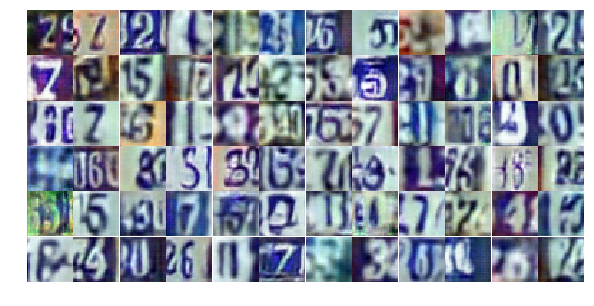

Epoch 16/20... Discriminator Loss: 0.7703... Generator Loss: 1.0593
Epoch 16/20... Discriminator Loss: 1.0407... Generator Loss: 0.6826
Epoch 16/20... Discriminator Loss: 0.8564... Generator Loss: 0.9202
Epoch 16/20... Discriminator Loss: 0.8577... Generator Loss: 0.9222
Epoch 16/20... Discriminator Loss: 0.8424... Generator Loss: 1.0412
Epoch 16/20... Discriminator Loss: 0.8370... Generator Loss: 0.9500
Epoch 16/20... Discriminator Loss: 1.3527... Generator Loss: 0.4735
Epoch 16/20... Discriminator Loss: 1.0836... Generator Loss: 0.6371
Epoch 16/20... Discriminator Loss: 1.0385... Generator Loss: 0.6130
Epoch 16/20... Discriminator Loss: 0.7296... Generator Loss: 1.1183


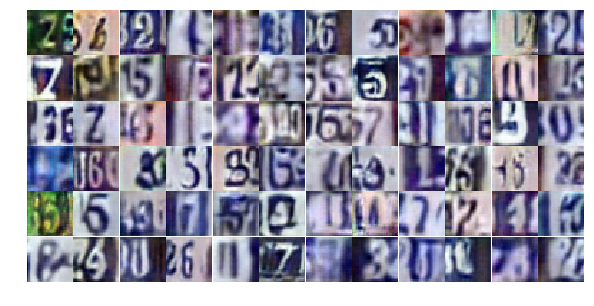

Epoch 16/20... Discriminator Loss: 1.0777... Generator Loss: 1.1229
Epoch 16/20... Discriminator Loss: 0.7906... Generator Loss: 0.9042
Epoch 16/20... Discriminator Loss: 1.0094... Generator Loss: 0.9567
Epoch 16/20... Discriminator Loss: 1.6669... Generator Loss: 0.3260
Epoch 16/20... Discriminator Loss: 1.1722... Generator Loss: 1.9512
Epoch 16/20... Discriminator Loss: 1.0028... Generator Loss: 0.9822
Epoch 16/20... Discriminator Loss: 1.1387... Generator Loss: 0.6025
Epoch 16/20... Discriminator Loss: 0.7186... Generator Loss: 1.3111
Epoch 16/20... Discriminator Loss: 0.5658... Generator Loss: 1.5279
Epoch 16/20... Discriminator Loss: 0.8394... Generator Loss: 1.2651


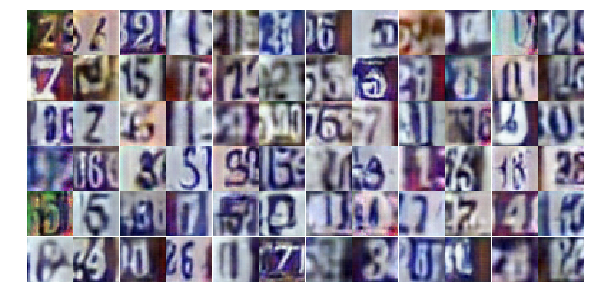

Epoch 16/20... Discriminator Loss: 0.8883... Generator Loss: 1.0384
Epoch 16/20... Discriminator Loss: 0.7249... Generator Loss: 1.2743
Epoch 16/20... Discriminator Loss: 0.9246... Generator Loss: 0.8314
Epoch 16/20... Discriminator Loss: 1.2319... Generator Loss: 0.5070
Epoch 16/20... Discriminator Loss: 0.8255... Generator Loss: 1.0247
Epoch 16/20... Discriminator Loss: 1.0286... Generator Loss: 0.6263
Epoch 16/20... Discriminator Loss: 0.9552... Generator Loss: 0.7298
Epoch 16/20... Discriminator Loss: 0.7493... Generator Loss: 1.6468
Epoch 16/20... Discriminator Loss: 1.1383... Generator Loss: 0.6101
Epoch 16/20... Discriminator Loss: 0.7718... Generator Loss: 0.9885


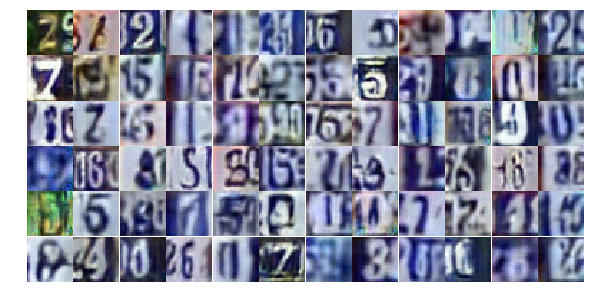

Epoch 16/20... Discriminator Loss: 0.8916... Generator Loss: 0.7446
Epoch 16/20... Discriminator Loss: 1.0066... Generator Loss: 0.7065
Epoch 16/20... Discriminator Loss: 0.9202... Generator Loss: 0.7794
Epoch 16/20... Discriminator Loss: 0.8974... Generator Loss: 1.9444
Epoch 16/20... Discriminator Loss: 0.9547... Generator Loss: 0.8615
Epoch 16/20... Discriminator Loss: 0.6771... Generator Loss: 1.3009
Epoch 16/20... Discriminator Loss: 0.9505... Generator Loss: 0.6808
Epoch 16/20... Discriminator Loss: 1.2134... Generator Loss: 0.5030
Epoch 16/20... Discriminator Loss: 1.1112... Generator Loss: 0.6085
Epoch 16/20... Discriminator Loss: 0.6354... Generator Loss: 1.2237


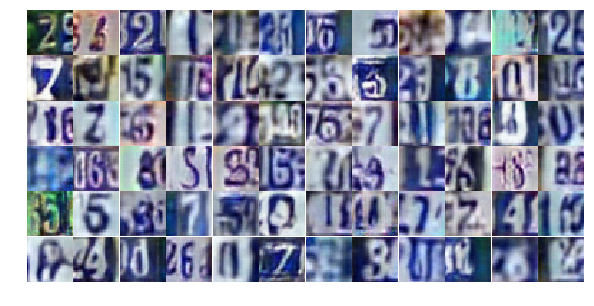

Epoch 16/20... Discriminator Loss: 0.6677... Generator Loss: 1.2005
Epoch 16/20... Discriminator Loss: 0.8105... Generator Loss: 1.2117
Epoch 16/20... Discriminator Loss: 0.8348... Generator Loss: 0.7803
Epoch 16/20... Discriminator Loss: 1.0973... Generator Loss: 0.6760
Epoch 16/20... Discriminator Loss: 0.8447... Generator Loss: 1.0633
Epoch 16/20... Discriminator Loss: 1.0526... Generator Loss: 0.6695
Epoch 16/20... Discriminator Loss: 0.6341... Generator Loss: 1.3078
Epoch 16/20... Discriminator Loss: 1.2419... Generator Loss: 0.4986
Epoch 16/20... Discriminator Loss: 0.6611... Generator Loss: 2.0025
Epoch 16/20... Discriminator Loss: 0.9739... Generator Loss: 0.6984


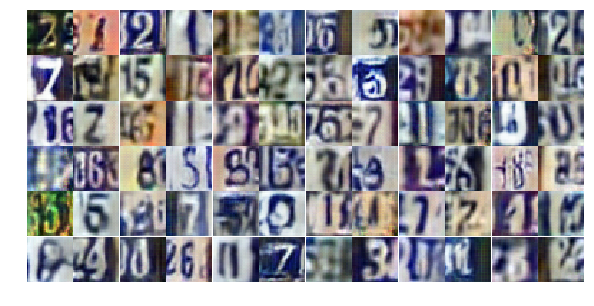

Epoch 16/20... Discriminator Loss: 1.3217... Generator Loss: 0.4731
Epoch 16/20... Discriminator Loss: 0.5855... Generator Loss: 1.1580
Epoch 16/20... Discriminator Loss: 1.6128... Generator Loss: 0.3245
Epoch 16/20... Discriminator Loss: 0.5551... Generator Loss: 1.1272
Epoch 16/20... Discriminator Loss: 0.9518... Generator Loss: 0.8486
Epoch 16/20... Discriminator Loss: 0.5868... Generator Loss: 1.1432
Epoch 17/20... Discriminator Loss: 0.4906... Generator Loss: 1.3004
Epoch 17/20... Discriminator Loss: 0.2793... Generator Loss: 2.6226
Epoch 17/20... Discriminator Loss: 0.3538... Generator Loss: 2.0246
Epoch 17/20... Discriminator Loss: 0.5721... Generator Loss: 1.1429


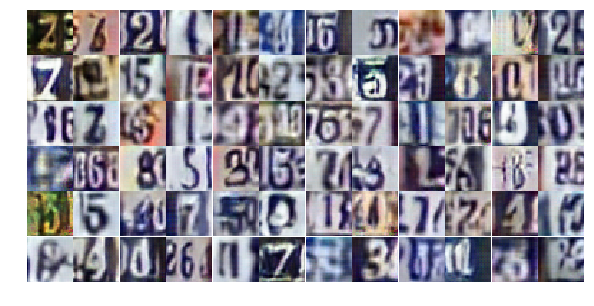

Epoch 17/20... Discriminator Loss: 0.1464... Generator Loss: 2.9830
Epoch 17/20... Discriminator Loss: 0.3194... Generator Loss: 1.8921
Epoch 17/20... Discriminator Loss: 3.2948... Generator Loss: 0.2179
Epoch 17/20... Discriminator Loss: 1.7085... Generator Loss: 0.7547
Epoch 17/20... Discriminator Loss: 1.4986... Generator Loss: 1.5106
Epoch 17/20... Discriminator Loss: 0.8750... Generator Loss: 1.0460
Epoch 17/20... Discriminator Loss: 0.6037... Generator Loss: 1.2107
Epoch 17/20... Discriminator Loss: 0.4781... Generator Loss: 1.4516
Epoch 17/20... Discriminator Loss: 0.3603... Generator Loss: 1.7164
Epoch 17/20... Discriminator Loss: 0.7739... Generator Loss: 1.1968


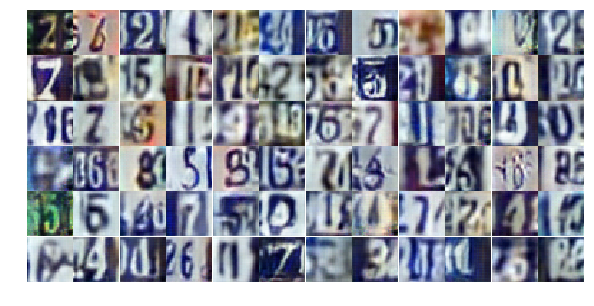

Epoch 17/20... Discriminator Loss: 0.9368... Generator Loss: 0.7223
Epoch 17/20... Discriminator Loss: 0.3835... Generator Loss: 1.8632
Epoch 17/20... Discriminator Loss: 0.1454... Generator Loss: 2.6967
Epoch 17/20... Discriminator Loss: 0.1785... Generator Loss: 3.2170
Epoch 17/20... Discriminator Loss: 0.1112... Generator Loss: 3.3019
Epoch 17/20... Discriminator Loss: 0.0833... Generator Loss: 3.2776
Epoch 17/20... Discriminator Loss: 0.3105... Generator Loss: 2.0870
Epoch 17/20... Discriminator Loss: 0.1793... Generator Loss: 2.4063
Epoch 17/20... Discriminator Loss: 0.1940... Generator Loss: 2.4808
Epoch 17/20... Discriminator Loss: 0.0969... Generator Loss: 3.1315


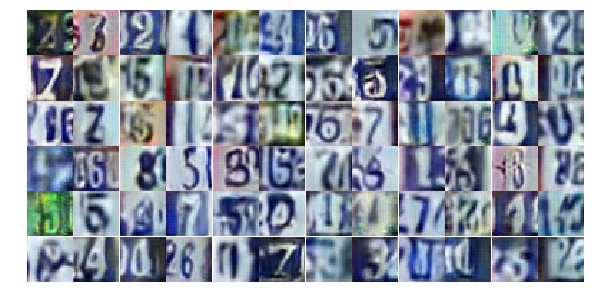

Epoch 17/20... Discriminator Loss: 0.9333... Generator Loss: 0.6657
Epoch 17/20... Discriminator Loss: 0.4568... Generator Loss: 1.3486
Epoch 17/20... Discriminator Loss: 2.2995... Generator Loss: 3.7127
Epoch 17/20... Discriminator Loss: 1.4829... Generator Loss: 0.6192
Epoch 17/20... Discriminator Loss: 0.8465... Generator Loss: 1.4353
Epoch 17/20... Discriminator Loss: 0.6822... Generator Loss: 1.1516
Epoch 17/20... Discriminator Loss: 0.7415... Generator Loss: 1.3923
Epoch 17/20... Discriminator Loss: 0.8804... Generator Loss: 0.8342
Epoch 17/20... Discriminator Loss: 1.1829... Generator Loss: 0.5672
Epoch 17/20... Discriminator Loss: 0.7410... Generator Loss: 0.9500


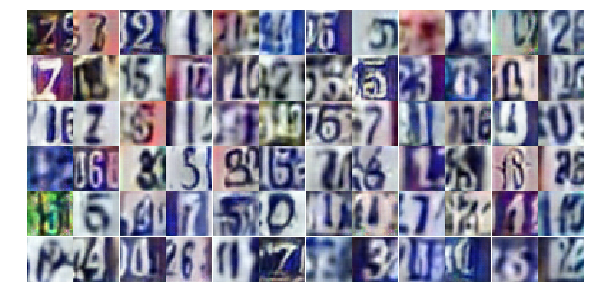

Epoch 17/20... Discriminator Loss: 0.7556... Generator Loss: 1.3944
Epoch 17/20... Discriminator Loss: 0.9398... Generator Loss: 1.1246
Epoch 17/20... Discriminator Loss: 0.7480... Generator Loss: 1.6603
Epoch 17/20... Discriminator Loss: 0.9897... Generator Loss: 0.7940
Epoch 17/20... Discriminator Loss: 0.8491... Generator Loss: 2.4957
Epoch 17/20... Discriminator Loss: 0.7904... Generator Loss: 1.1779
Epoch 17/20... Discriminator Loss: 0.9231... Generator Loss: 0.9142
Epoch 17/20... Discriminator Loss: 0.5790... Generator Loss: 1.3471
Epoch 17/20... Discriminator Loss: 0.4364... Generator Loss: 1.6108
Epoch 17/20... Discriminator Loss: 1.2216... Generator Loss: 0.4936


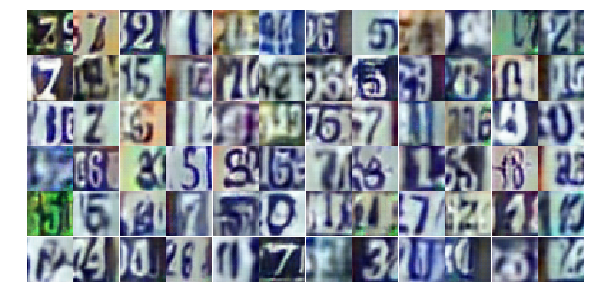

Epoch 17/20... Discriminator Loss: 1.3283... Generator Loss: 2.2538
Epoch 17/20... Discriminator Loss: 0.6211... Generator Loss: 1.7623
Epoch 17/20... Discriminator Loss: 0.9329... Generator Loss: 0.8478
Epoch 17/20... Discriminator Loss: 0.3665... Generator Loss: 2.1485
Epoch 17/20... Discriminator Loss: 1.0525... Generator Loss: 0.6414
Epoch 17/20... Discriminator Loss: 0.8763... Generator Loss: 1.5010
Epoch 17/20... Discriminator Loss: 1.1630... Generator Loss: 0.5314
Epoch 17/20... Discriminator Loss: 0.6897... Generator Loss: 1.0554
Epoch 17/20... Discriminator Loss: 0.8341... Generator Loss: 1.2484
Epoch 17/20... Discriminator Loss: 1.3207... Generator Loss: 0.4307


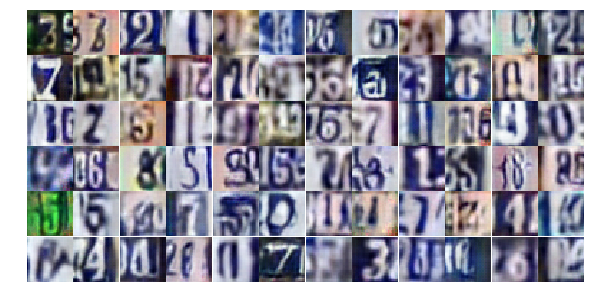

Epoch 17/20... Discriminator Loss: 0.8561... Generator Loss: 0.9951
Epoch 17/20... Discriminator Loss: 0.8706... Generator Loss: 0.8209
Epoch 17/20... Discriminator Loss: 0.5938... Generator Loss: 1.4416
Epoch 17/20... Discriminator Loss: 0.6450... Generator Loss: 1.5039
Epoch 18/20... Discriminator Loss: 0.7184... Generator Loss: 1.1531
Epoch 18/20... Discriminator Loss: 1.3057... Generator Loss: 0.4305
Epoch 18/20... Discriminator Loss: 0.8647... Generator Loss: 0.8396
Epoch 18/20... Discriminator Loss: 0.6845... Generator Loss: 1.8450
Epoch 18/20... Discriminator Loss: 1.1205... Generator Loss: 0.6185
Epoch 18/20... Discriminator Loss: 0.9606... Generator Loss: 1.0892


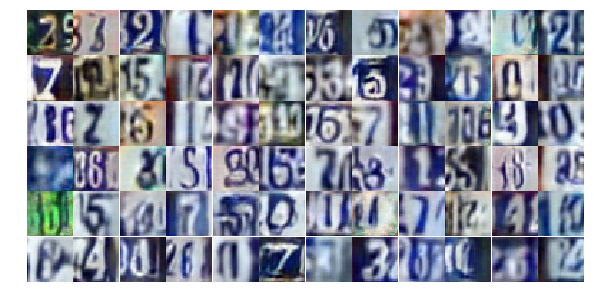

Epoch 18/20... Discriminator Loss: 0.4887... Generator Loss: 1.7977
Epoch 18/20... Discriminator Loss: 1.0282... Generator Loss: 0.6352
Epoch 18/20... Discriminator Loss: 0.8182... Generator Loss: 0.8955
Epoch 18/20... Discriminator Loss: 0.5601... Generator Loss: 1.5668
Epoch 18/20... Discriminator Loss: 0.8380... Generator Loss: 2.0137
Epoch 18/20... Discriminator Loss: 0.8568... Generator Loss: 0.8178
Epoch 18/20... Discriminator Loss: 0.8142... Generator Loss: 0.9375
Epoch 18/20... Discriminator Loss: 0.8947... Generator Loss: 0.7586
Epoch 18/20... Discriminator Loss: 0.6508... Generator Loss: 1.6133
Epoch 18/20... Discriminator Loss: 0.6552... Generator Loss: 1.3049


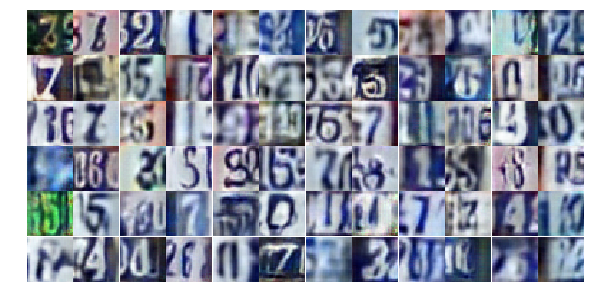

Epoch 18/20... Discriminator Loss: 0.8653... Generator Loss: 1.1374
Epoch 18/20... Discriminator Loss: 0.9098... Generator Loss: 0.7947
Epoch 18/20... Discriminator Loss: 1.0150... Generator Loss: 0.8577
Epoch 18/20... Discriminator Loss: 0.6026... Generator Loss: 1.3506
Epoch 18/20... Discriminator Loss: 1.0950... Generator Loss: 0.5545
Epoch 18/20... Discriminator Loss: 0.8676... Generator Loss: 0.8626
Epoch 18/20... Discriminator Loss: 0.6975... Generator Loss: 1.1156
Epoch 18/20... Discriminator Loss: 1.0206... Generator Loss: 0.6308
Epoch 18/20... Discriminator Loss: 0.6101... Generator Loss: 1.5748
Epoch 18/20... Discriminator Loss: 0.3937... Generator Loss: 2.4577


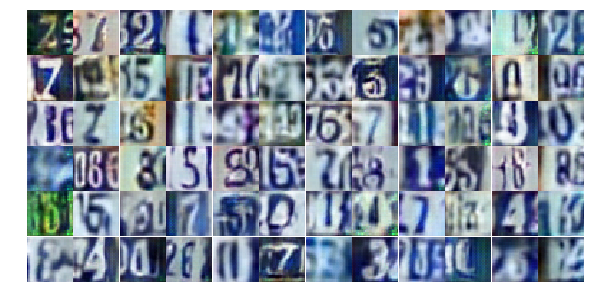

Epoch 18/20... Discriminator Loss: 0.4341... Generator Loss: 1.7511
Epoch 18/20... Discriminator Loss: 0.2480... Generator Loss: 2.8931
Epoch 18/20... Discriminator Loss: 0.2523... Generator Loss: 2.3666
Epoch 18/20... Discriminator Loss: 0.7447... Generator Loss: 0.8746
Epoch 18/20... Discriminator Loss: 0.2934... Generator Loss: 1.8008
Epoch 18/20... Discriminator Loss: 0.2461... Generator Loss: 2.0486
Epoch 18/20... Discriminator Loss: 0.3521... Generator Loss: 2.0484
Epoch 18/20... Discriminator Loss: 0.3539... Generator Loss: 2.0787
Epoch 18/20... Discriminator Loss: 1.5435... Generator Loss: 4.4542
Epoch 18/20... Discriminator Loss: 0.7600... Generator Loss: 1.3396


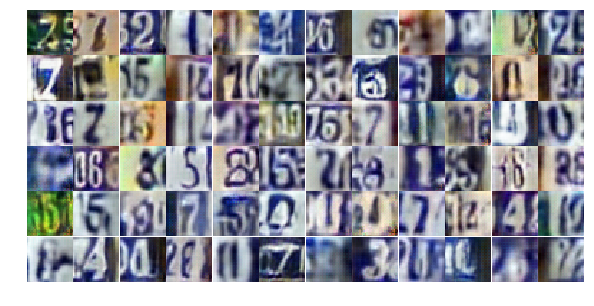

Epoch 18/20... Discriminator Loss: 0.8332... Generator Loss: 0.9995
Epoch 18/20... Discriminator Loss: 0.5923... Generator Loss: 1.3239
Epoch 18/20... Discriminator Loss: 0.7511... Generator Loss: 0.9069
Epoch 18/20... Discriminator Loss: 0.9133... Generator Loss: 0.7385
Epoch 18/20... Discriminator Loss: 0.5440... Generator Loss: 2.0480
Epoch 18/20... Discriminator Loss: 0.5095... Generator Loss: 1.1898
Epoch 18/20... Discriminator Loss: 0.7539... Generator Loss: 0.9943
Epoch 18/20... Discriminator Loss: 1.7998... Generator Loss: 3.4405
Epoch 18/20... Discriminator Loss: 0.6570... Generator Loss: 1.1183
Epoch 18/20... Discriminator Loss: 0.2499... Generator Loss: 2.7038


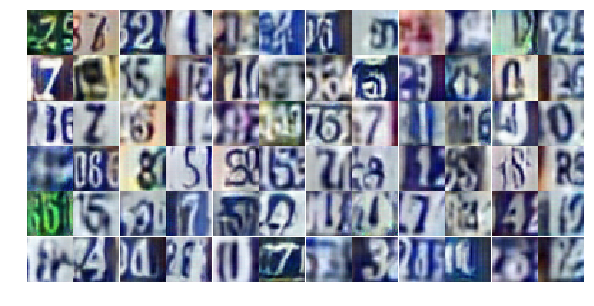

Epoch 18/20... Discriminator Loss: 0.5558... Generator Loss: 1.3971
Epoch 18/20... Discriminator Loss: 0.6272... Generator Loss: 1.1692
Epoch 18/20... Discriminator Loss: 0.7533... Generator Loss: 0.9593
Epoch 18/20... Discriminator Loss: 0.3556... Generator Loss: 1.7724
Epoch 18/20... Discriminator Loss: 0.4484... Generator Loss: 1.3512
Epoch 18/20... Discriminator Loss: 0.3287... Generator Loss: 3.1395
Epoch 18/20... Discriminator Loss: 0.3579... Generator Loss: 1.7545
Epoch 18/20... Discriminator Loss: 0.1229... Generator Loss: 4.2161
Epoch 18/20... Discriminator Loss: 0.4523... Generator Loss: 1.8385
Epoch 18/20... Discriminator Loss: 0.3527... Generator Loss: 1.7839


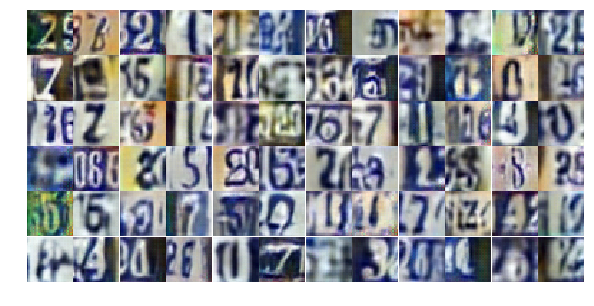

Epoch 18/20... Discriminator Loss: 0.4211... Generator Loss: 1.3638
Epoch 19/20... Discriminator Loss: 0.8326... Generator Loss: 0.8256
Epoch 19/20... Discriminator Loss: 0.5071... Generator Loss: 1.2004
Epoch 19/20... Discriminator Loss: 0.8333... Generator Loss: 0.7715
Epoch 19/20... Discriminator Loss: 0.2813... Generator Loss: 1.9716
Epoch 19/20... Discriminator Loss: 0.5641... Generator Loss: 1.2201
Epoch 19/20... Discriminator Loss: 0.2873... Generator Loss: 2.9321
Epoch 19/20... Discriminator Loss: 0.1398... Generator Loss: 2.8608
Epoch 19/20... Discriminator Loss: 1.2759... Generator Loss: 3.5054
Epoch 19/20... Discriminator Loss: 1.0522... Generator Loss: 2.7114


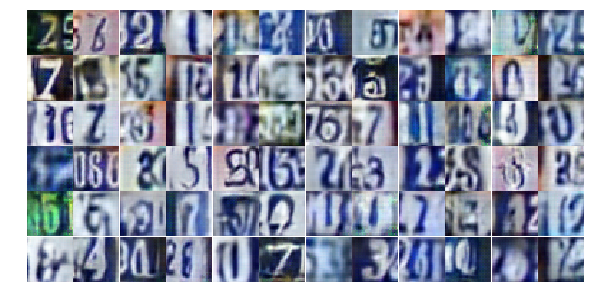

Epoch 19/20... Discriminator Loss: 1.1944... Generator Loss: 1.7628
Epoch 19/20... Discriminator Loss: 1.0330... Generator Loss: 1.2161
Epoch 19/20... Discriminator Loss: 1.4279... Generator Loss: 0.7860
Epoch 19/20... Discriminator Loss: 1.0796... Generator Loss: 0.7723
Epoch 19/20... Discriminator Loss: 1.0966... Generator Loss: 0.7624
Epoch 19/20... Discriminator Loss: 1.0222... Generator Loss: 0.7447
Epoch 19/20... Discriminator Loss: 0.8839... Generator Loss: 1.4129
Epoch 19/20... Discriminator Loss: 0.8201... Generator Loss: 1.2118
Epoch 19/20... Discriminator Loss: 0.8338... Generator Loss: 1.1963
Epoch 19/20... Discriminator Loss: 1.3614... Generator Loss: 0.4498


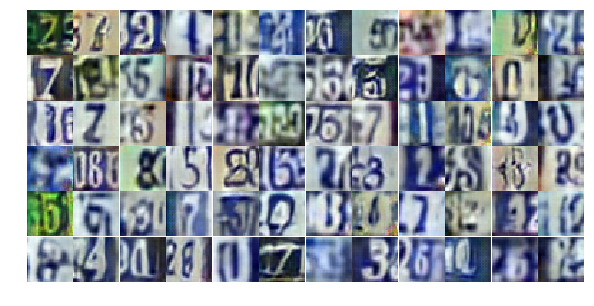

Epoch 19/20... Discriminator Loss: 0.9306... Generator Loss: 0.8187
Epoch 19/20... Discriminator Loss: 1.1743... Generator Loss: 0.6303
Epoch 19/20... Discriminator Loss: 1.4768... Generator Loss: 0.4262
Epoch 19/20... Discriminator Loss: 0.9867... Generator Loss: 1.2374
Epoch 19/20... Discriminator Loss: 1.0872... Generator Loss: 0.6463
Epoch 19/20... Discriminator Loss: 0.9161... Generator Loss: 0.7678
Epoch 19/20... Discriminator Loss: 0.7201... Generator Loss: 1.1340
Epoch 19/20... Discriminator Loss: 0.7039... Generator Loss: 1.8556
Epoch 19/20... Discriminator Loss: 0.9494... Generator Loss: 0.7269
Epoch 19/20... Discriminator Loss: 1.2912... Generator Loss: 0.4901


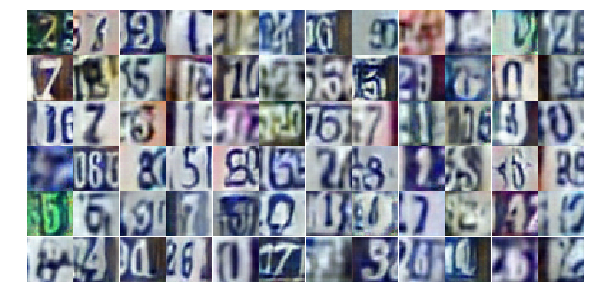

Epoch 19/20... Discriminator Loss: 0.7605... Generator Loss: 0.9458
Epoch 19/20... Discriminator Loss: 0.7123... Generator Loss: 1.0734
Epoch 19/20... Discriminator Loss: 1.0280... Generator Loss: 0.6482
Epoch 19/20... Discriminator Loss: 0.7912... Generator Loss: 1.1289
Epoch 19/20... Discriminator Loss: 0.9219... Generator Loss: 0.9907
Epoch 19/20... Discriminator Loss: 1.6031... Generator Loss: 0.3520
Epoch 19/20... Discriminator Loss: 0.8683... Generator Loss: 1.1314
Epoch 19/20... Discriminator Loss: 0.6827... Generator Loss: 1.2753
Epoch 19/20... Discriminator Loss: 1.1508... Generator Loss: 0.5836
Epoch 19/20... Discriminator Loss: 0.7411... Generator Loss: 1.3005


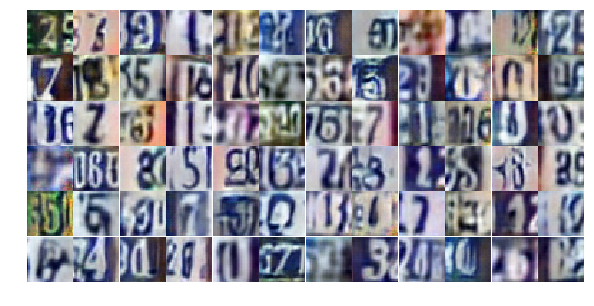

Epoch 19/20... Discriminator Loss: 0.6451... Generator Loss: 1.7926
Epoch 19/20... Discriminator Loss: 1.0388... Generator Loss: 0.7235
Epoch 19/20... Discriminator Loss: 0.8897... Generator Loss: 0.8314
Epoch 19/20... Discriminator Loss: 0.5696... Generator Loss: 1.4966
Epoch 19/20... Discriminator Loss: 0.8388... Generator Loss: 1.4169
Epoch 19/20... Discriminator Loss: 0.6597... Generator Loss: 1.4602
Epoch 19/20... Discriminator Loss: 1.2254... Generator Loss: 2.1619
Epoch 19/20... Discriminator Loss: 0.5125... Generator Loss: 1.3515
Epoch 19/20... Discriminator Loss: 1.1638... Generator Loss: 0.5612
Epoch 19/20... Discriminator Loss: 0.9132... Generator Loss: 0.8497


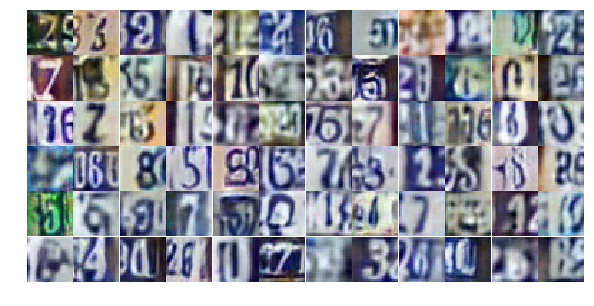

Epoch 19/20... Discriminator Loss: 0.5831... Generator Loss: 1.5674
Epoch 19/20... Discriminator Loss: 0.7620... Generator Loss: 1.5952
Epoch 19/20... Discriminator Loss: 0.6403... Generator Loss: 1.4508
Epoch 19/20... Discriminator Loss: 0.8186... Generator Loss: 0.8678
Epoch 19/20... Discriminator Loss: 0.6425... Generator Loss: 1.6911
Epoch 19/20... Discriminator Loss: 0.7692... Generator Loss: 1.6042
Epoch 19/20... Discriminator Loss: 1.8212... Generator Loss: 0.2423
Epoch 19/20... Discriminator Loss: 0.6902... Generator Loss: 1.1550
Epoch 20/20... Discriminator Loss: 0.7750... Generator Loss: 1.0058
Epoch 20/20... Discriminator Loss: 0.9016... Generator Loss: 0.9421


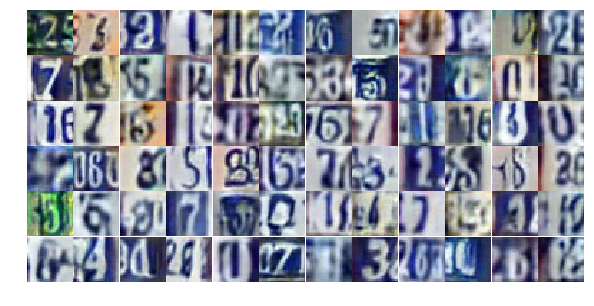

Epoch 20/20... Discriminator Loss: 0.9309... Generator Loss: 0.8383
Epoch 20/20... Discriminator Loss: 0.9679... Generator Loss: 0.8065
Epoch 20/20... Discriminator Loss: 1.2625... Generator Loss: 0.6018
Epoch 20/20... Discriminator Loss: 1.7588... Generator Loss: 0.2652
Epoch 20/20... Discriminator Loss: 0.6876... Generator Loss: 1.1252
Epoch 20/20... Discriminator Loss: 0.8099... Generator Loss: 0.9460
Epoch 20/20... Discriminator Loss: 0.6755... Generator Loss: 1.1511
Epoch 20/20... Discriminator Loss: 0.8928... Generator Loss: 1.8854
Epoch 20/20... Discriminator Loss: 0.9357... Generator Loss: 0.9976
Epoch 20/20... Discriminator Loss: 1.1590... Generator Loss: 0.5761


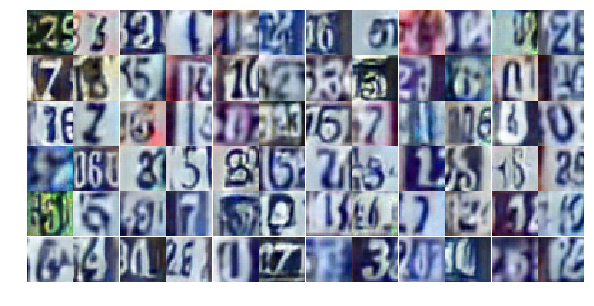

Epoch 20/20... Discriminator Loss: 0.9524... Generator Loss: 0.7237
Epoch 20/20... Discriminator Loss: 1.0768... Generator Loss: 0.6932
Epoch 20/20... Discriminator Loss: 0.8612... Generator Loss: 1.9772
Epoch 20/20... Discriminator Loss: 1.2364... Generator Loss: 0.7372
Epoch 20/20... Discriminator Loss: 1.1983... Generator Loss: 0.6203
Epoch 20/20... Discriminator Loss: 1.3397... Generator Loss: 0.5115
Epoch 20/20... Discriminator Loss: 0.5704... Generator Loss: 1.2385
Epoch 20/20... Discriminator Loss: 0.7387... Generator Loss: 1.0591
Epoch 20/20... Discriminator Loss: 0.6933... Generator Loss: 1.2252
Epoch 20/20... Discriminator Loss: 0.9539... Generator Loss: 0.7217


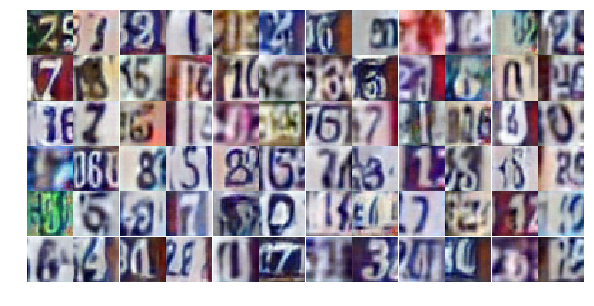

Epoch 20/20... Discriminator Loss: 0.6032... Generator Loss: 1.3154
Epoch 20/20... Discriminator Loss: 0.9492... Generator Loss: 0.9872
Epoch 20/20... Discriminator Loss: 0.3982... Generator Loss: 1.9763
Epoch 20/20... Discriminator Loss: 1.2071... Generator Loss: 0.5237
Epoch 20/20... Discriminator Loss: 1.1898... Generator Loss: 0.5353
Epoch 20/20... Discriminator Loss: 0.6094... Generator Loss: 1.2254
Epoch 20/20... Discriminator Loss: 0.7552... Generator Loss: 1.0643
Epoch 20/20... Discriminator Loss: 1.5875... Generator Loss: 0.3875
Epoch 20/20... Discriminator Loss: 0.7591... Generator Loss: 0.8761
Epoch 20/20... Discriminator Loss: 0.4942... Generator Loss: 1.3019


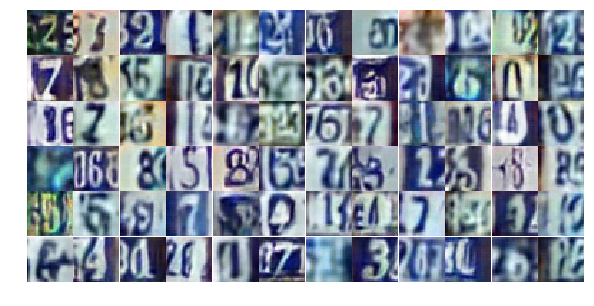

Epoch 20/20... Discriminator Loss: 0.6876... Generator Loss: 1.0912
Epoch 20/20... Discriminator Loss: 0.3410... Generator Loss: 1.6788
Epoch 20/20... Discriminator Loss: 0.6361... Generator Loss: 1.0596
Epoch 20/20... Discriminator Loss: 0.3369... Generator Loss: 2.4379
Epoch 20/20... Discriminator Loss: 0.3652... Generator Loss: 1.7770
Epoch 20/20... Discriminator Loss: 0.3073... Generator Loss: 2.2059
Epoch 20/20... Discriminator Loss: 0.4482... Generator Loss: 1.5205
Epoch 20/20... Discriminator Loss: 0.3815... Generator Loss: 1.5691
Epoch 20/20... Discriminator Loss: 0.2493... Generator Loss: 2.5581
Epoch 20/20... Discriminator Loss: 0.7441... Generator Loss: 0.8274


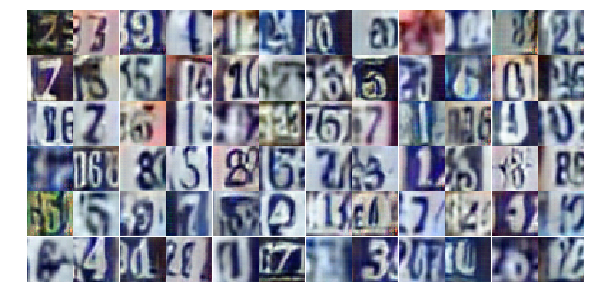

Epoch 20/20... Discriminator Loss: 0.1371... Generator Loss: 2.8305
Epoch 20/20... Discriminator Loss: 0.3903... Generator Loss: 1.6084
Epoch 20/20... Discriminator Loss: 1.7488... Generator Loss: 0.3242
Epoch 20/20... Discriminator Loss: 1.6993... Generator Loss: 0.6596
Epoch 20/20... Discriminator Loss: 1.0651... Generator Loss: 0.8762
Epoch 20/20... Discriminator Loss: 1.6108... Generator Loss: 0.3746
Epoch 20/20... Discriminator Loss: 1.4652... Generator Loss: 0.3955
Epoch 20/20... Discriminator Loss: 0.5418... Generator Loss: 1.4613
Epoch 20/20... Discriminator Loss: 0.7123... Generator Loss: 1.2282
Epoch 20/20... Discriminator Loss: 0.5394... Generator Loss: 1.3955


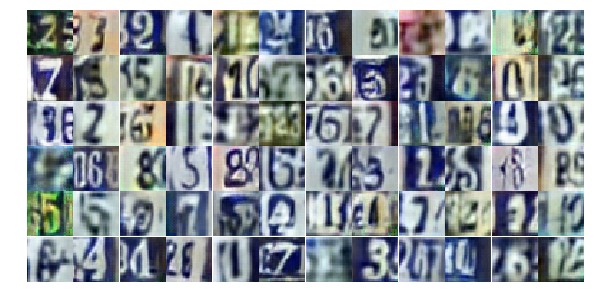

Epoch 20/20... Discriminator Loss: 0.4265... Generator Loss: 1.7129
Epoch 20/20... Discriminator Loss: 0.2980... Generator Loss: 2.2261
Epoch 20/20... Discriminator Loss: 0.3904... Generator Loss: 1.8787
Epoch 20/20... Discriminator Loss: 0.8518... Generator Loss: 0.8511
Epoch 20/20... Discriminator Loss: 0.8325... Generator Loss: 0.8748
Epoch 20/20... Discriminator Loss: 0.4973... Generator Loss: 1.2589


In [22]:
# Load the data and train the network here
dataset = Dataset(trainset, testset)
losses, samples = train(net, dataset, epochs, batch_size, figsize=(10,5))

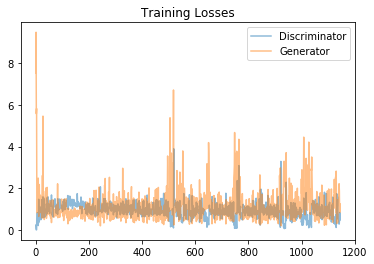

In [23]:
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

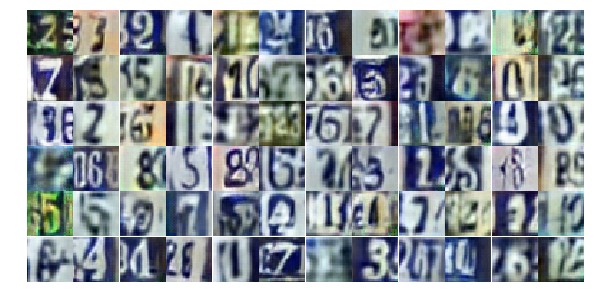

In [24]:
_ = view_samples(-1, samples, 6, 12, figsize=(10,5))